In [1]:
# from cosine_annealing_warmup import CosineAnnealingWarmupRestarts
import sys
import gc
import glob
import math
import os
import pickle
import random
import shutil
import warnings
from collections import OrderedDict
from pathlib import Path

import albumentations as albu
import cv2
import matplotlib.pyplot as plt

# import mlflow
import numpy as np
import pandas as pd
import timm
import torch
import torch.optim as optim
from sklearn.metrics import accuracy_score, f1_score, mean_squared_error, roc_auc_score
from sklearn.model_selection import KFold, StratifiedGroupKFold, StratifiedKFold
from torch import nn
from torch.utils.data import DataLoader, Dataset
from tqdm import tqdm

warnings.simplefilter("ignore")

In [2]:
is_train = True

EXP_NAME = "expy003"
ROOT_DIR = Path("/working")
DATA_DIR = Path("/working/input/vesuvius-challenge-ink-detection")
OUTPUT_DIR = Path(f"/working/output/{EXP_NAME}")

def to_pickle(filename, obj):
    with open(filename, mode="wb") as f:
        pickle.dump(obj, f)


def unpickle(filename):
    with open(filename, mode="rb") as fo:
        p = pickle.load(fo)
    return p

# Config

In [3]:
import multiprocessing

print("cpu count:", multiprocessing.cpu_count())


class Config:
    N_LABEL = 10
    N_FOLD = 5
    RANDOM_SATE = 42
    LR = 2.0e-03
    MAX_LR = 2.0e-3
    PATIENCE = 50
    EPOCH = 35
    BATCH_SIZE = 4
    SKIP_EVALUATE_NUM = 0
    BACK_BONE = "seresnext50_32x4d"
    RUN_FOLD_COUNT = 10
    IMG_SIZE = 672
    T_MAX = 8
    ETA_MIN = 1.0e-3
    SCHEDULER_GAMMA = 1.0
    ACCUMULATION_STEMP = 2
    NUM_WORKERS = multiprocessing.cpu_count()
    IN_CHANNELS = 4
    PREDICT_STRIDE = 10


def seed_everything(seed=1234):
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False


seed_everything(seed=Config.RANDOM_SATE)

cpu count: 20


In [4]:
glob.glob(str(DATA_DIR / "*"))

['/working/input/vesuvius-challenge-ink-detection/sample_submission.csv',
 '/working/input/vesuvius-challenge-ink-detection/test',
 '/working/input/vesuvius-challenge-ink-detection/train']

In [5]:
from io import StringIO

import numpy as np


def rle(output, thr):
    flat_img = np.where(output > thr, 1, 0).astype(np.uint8)
    starts = np.array((flat_img[:-1] == 0) & (flat_img[1:] == 1))
    ends = np.array((flat_img[:-1] == 1) & (flat_img[1:] == 0))
    starts_ix = np.where(starts)[0] + 2
    ends_ix = np.where(ends)[0] + 2
    lengths = ends_ix - starts_ix
    return starts_ix, lengths


def concat_tile(im_list_2d):
    return cv2.vconcat([cv2.hconcat(im_list_h) for im_list_h in im_list_2d])

In [6]:
mid = 65 // 2
start = mid - Config.IN_CHANNELS * 3 // 2
end = mid + Config.IN_CHANNELS * 3 // 2
idxs = range(start, end, 3)
print([i for i in idxs])

idxs2 = range(start - 1, end - 1, 3)
print([i for i in idxs2])

idxs3 = range(start + 1, end + 1, 3)
print([i for i in idxs3])

[26, 29, 32, 35]
[25, 28, 31, 34]
[27, 30, 33, 36]


In [7]:
from sklearn.preprocessing import MinMaxScaler
mms = MinMaxScaler(feature_range=(0, 1))


img = mms.fit_transform(cv2.imread(str(DATA_DIR / f"train/2/ir.png"), 0))

In [8]:
import math

e = math.e
def sigmoid(a):
    s = 1 / (1 + e**-a)
    return s

# Load imgs

In [9]:
if is_train:

    img1 = []
    for i in tqdm(idxs):
        img1.append(cv2.imread(str(DATA_DIR / f"train/1/surface_volume/{i:02}.tif"), 0))

    img2 = []
    for i in tqdm(idxs):
        img2.append(
            cv2.imread(str(DATA_DIR / f"train/2/surface_volume/{i:02}.tif"), 0)[
                0:4943, :
            ]
        )

    img3 = []
    for i in tqdm(idxs):
        img3.append(cv2.imread(str(DATA_DIR / f"train/3/surface_volume/{i:02}.tif"), 0))

    img4 = []
    for i in tqdm(idxs):
        img4.append(
            cv2.imread(str(DATA_DIR / f"train/2/surface_volume/{i:02}.tif"), 0)[
                4943:9886, :
            ]
        )

    img5 = []
    for i in tqdm(idxs):
        img5.append(
            cv2.imread(str(DATA_DIR / f"train/2/surface_volume/{i:02}.tif"), 0)[
                9886:, :
            ]
        )

    img1 = np.stack(img1)
    img2 = np.stack(img2)
    img3 = np.stack(img3)
    img4 = np.stack(img4)
    img5 = np.stack(img5)

    img1_1 = []
    for i in tqdm(idxs2):
        img1_1.append(
            cv2.imread(str(DATA_DIR / f"train/1/surface_volume/{i:02}.tif"), 0)
        )

    img2_1 = []
    for i in tqdm(idxs2):
        img2_1.append(
            cv2.imread(str(DATA_DIR / f"train/2/surface_volume/{i:02}.tif"), 0)[
                0:4943, :
            ]
        )

    img3_1 = []
    for i in tqdm(idxs2):
        img3_1.append(
            cv2.imread(str(DATA_DIR / f"train/3/surface_volume/{i:02}.tif"), 0)
        )

    img4_1 = []
    for i in tqdm(idxs):
        img4_1.append(
            cv2.imread(str(DATA_DIR / f"train/2/surface_volume/{i:02}.tif"), 0)[
                4943:9886, :
            ]
        )

    img5_1 = []
    for i in tqdm(idxs):
        img5_1.append(
            cv2.imread(str(DATA_DIR / f"train/2/surface_volume/{i:02}.tif"), 0)[
                9886:, :
            ]
        )

    img1_1 = np.stack(img1_1)
    img2_1 = np.stack(img2_1)
    img3_1 = np.stack(img3_1)
    img4_1 = np.stack(img4_1)
    img5_1 = np.stack(img5_1)

    img1_2 = []
    for i in tqdm(idxs3):
        img1_2.append(
            cv2.imread(str(DATA_DIR / f"train/1/surface_volume/{i:02}.tif"), 0)
        )

    img2_2 = []
    for i in tqdm(idxs3):
        img2_2.append(
            cv2.imread(str(DATA_DIR / f"train/2/surface_volume/{i:02}.tif"), 0)[
                0:4943, :
            ]
        )

    img3_2 = []
    for i in tqdm(idxs3):
        img3_2.append(
            cv2.imread(str(DATA_DIR / f"train/3/surface_volume/{i:02}.tif"), 0)
        )

    img4_2 = []
    for i in tqdm(idxs):
        img4_2.append(
            cv2.imread(str(DATA_DIR / f"train/2/surface_volume/{i:02}.tif"), 0)[
                4943:9886, :
            ]
        )

    img5_2 = []
    for i in tqdm(idxs):
        img5_2.append(
            cv2.imread(str(DATA_DIR / f"train/2/surface_volume/{i:02}.tif"), 0)[
                9886:, :
            ]
        )

    img1_2 = np.stack(img1_2)
    img2_2 = np.stack(img2_2)
    img3_2 = np.stack(img3_2)
    img4_2 = np.stack(img4_2)
    img5_2 = np.stack(img5_2)

    img1_label = cv2.imread(str(DATA_DIR / f"train/1/inklabels.png"), 0)
    img2_label = cv2.imread(str(DATA_DIR / f"train/2/inklabels.png"), 0)[0:4943, :]
    img3_label = cv2.imread(str(DATA_DIR / f"train/3/inklabels.png"), 0)
    img4_label = cv2.imread(str(DATA_DIR / f"train/2/inklabels.png"), 0)[4943:9886, :]
    img5_label = cv2.imread(str(DATA_DIR / f"train/2/inklabels.png"), 0)[9886:, :]


    mms = MinMaxScaler(feature_range=(0, 1))
    img1_ir = abs(mms.fit_transform(cv2.imread(str(DATA_DIR / f"train/1/ir.png"), 0))-1) * cv2.imread(str(DATA_DIR / f"train/1/inklabels.png"), 0)
    mms = MinMaxScaler(feature_range=(0, 1))
    img2_ir = (abs(mms.fit_transform(cv2.imread(str(DATA_DIR / f"train/2/ir.png"), 0))-1) * cv2.imread(str(DATA_DIR / f"train/2/inklabels.png"), 0))[0:4943, :]
    mms = MinMaxScaler(feature_range=(0, 1))
    img3_ir = abs(mms.fit_transform(cv2.imread(str(DATA_DIR / f"train/3/ir.png"), 0))-1) * cv2.imread(str(DATA_DIR / f"train/3/inklabels.png"), 0)
    mms = MinMaxScaler(feature_range=(0, 1))
    img4_ir = (abs(mms.fit_transform(cv2.imread(str(DATA_DIR / f"train/2/ir.png"), 0))-1) * cv2.imread(str(DATA_DIR / f"train/2/inklabels.png"), 0))[4943:9886, :]
    mms = MinMaxScaler(feature_range=(0, 1))
    img5_ir = (abs(mms.fit_transform(cv2.imread(str(DATA_DIR / f"train/2/ir.png"), 0))-1) * cv2.imread(str(DATA_DIR / f"train/2/inklabels.png"), 0))[9886:, :]
    
    img1_mask = cv2.imread(str(DATA_DIR / f"train/1/mask.png"), 0)
    img2_mask = cv2.imread(str(DATA_DIR / f"train/2/mask.png"), 0)[0:4943, :]
    img3_mask = cv2.imread(str(DATA_DIR / f"train/3/mask.png"), 0)
    img4_mask = cv2.imread(str(DATA_DIR / f"train/2/mask.png"), 0)[4943:9886, :]
    img5_mask = cv2.imread(str(DATA_DIR / f"train/2/mask.png"), 0)[9886:, :]

100%|██████████| 4/4 [00:41<00:00, 10.27s/it]


# Dataset

In [10]:
def get_augmentation():
    train_transform = [
        albu.Resize(height=Config.IMG_SIZE, width=Config.IMG_SIZE),
        albu.HorizontalFlip(p=0.5),
        albu.VerticalFlip(p=0.5),
        albu.RandomBrightnessContrast(p=0.75),
        albu.ShiftScaleRotate(p=0.75, scale_limit=0.2),
        albu.OneOf(
            [
                albu.GaussNoise(var_limit=[20, 100]),
                albu.GaussianBlur(),
                albu.MotionBlur(),
            ],
            p=0.3,
        ),
        albu.GridDistortion(num_steps=5, distort_limit=0.3, p=0.5),
        albu.CoarseDropout(
            max_holes=1,
            max_width=int(Config.IMG_SIZE * 0.3),
            max_height=int(Config.IMG_SIZE * 0.3),
            mask_fill_value=0,
            p=0.5,
        ),
        # albu.Cutout(max_h_size=int(size * 0.6),
        #          max_w_size=int(size * 0.6), num_holes=1, p=1.0),
        albu.Normalize(mean=[0] * Config.IN_CHANNELS, std=[1] * Config.IN_CHANNELS),
    ]
    return albu.Compose(train_transform)


def get_test_augmentation():
    train_transform = [
        albu.Resize(height=Config.IMG_SIZE, width=Config.IMG_SIZE),
        albu.Normalize(mean=[0] * Config.IN_CHANNELS, std=[1] * Config.IN_CHANNELS),
    ]
    return albu.Compose(train_transform)

In [11]:
class CVDataSet(Dataset):
    def __init__(self, imgs, transforms, labels=None, data_type=None, crop_size=256):
        self.crop_size = crop_size
        self.imgs = imgs
        self.transforms = transforms
        self.labels = labels
        self.data_type = data_type

        self.cell_counts = []
        for img in self.imgs:
            cell_count = math.ceil(img.shape[1] / self.crop_size) * math.ceil(
                img.shape[2] / self.crop_size
            )
            self.cell_counts.append(cell_count)

    def __len__(self):
        data_count = 0
        if self.data_type == "train":

            self.cell_id_maps = {}

            counter = 0
            for img_num, img in enumerate(self.imgs):

                cell_count = math.ceil(img.shape[1] / self.crop_size) * math.ceil(
                    img.shape[2] / self.crop_size
                )
                for cell_id in range(cell_count):
                    h_num = cell_id // math.ceil(
                        self.labels[img_num].shape[1] / self.crop_size
                    )
                    w_num = cell_id - (
                        h_num
                        * math.ceil(self.labels[img_num].shape[1] / self.crop_size)
                    )

                    cropped_img = self.labels[img_num][
                        h_num * self.crop_size : h_num * self.crop_size
                        + self.crop_size,
                        w_num * self.crop_size : w_num * self.crop_size
                        + self.crop_size,
                    ]

                    if cropped_img.sum() == 0:
                        continue

                    data_count += 1

                    self.cell_id_maps[counter] = (img_num, cell_id)
                    counter += 1

        else:

            for img in self.imgs:
                data_count += math.ceil(img.shape[1] / self.crop_size) * math.ceil(
                    img.shape[2] / self.crop_size
                )
        return data_count

    def calc_img_num(self, idx):
        cum_cell_count = 0
        for i, cell_count in enumerate(self.cell_counts):
            cum_cell_count += cell_count
            if idx + 1 <= cum_cell_count:
                return i, idx - (cum_cell_count - cell_count)

    def __getitem__(self, idx):
        shift_size = 0
        if self.data_type == "train":
            img_num, cell_id = self.cell_id_maps[idx]
            if random.random() > 0.6:
                shift_size = int(
                    random.uniform(-(self.crop_size // 8), self.crop_size // 8)
                )
        else:
            img_num, cell_id = self.calc_img_num(idx)

        target_img = self.imgs[img_num]
        if self.data_type != "test":
            target_label = self.labels[img_num]

        # print(target_label.shape)
        target_img = np.moveaxis(target_img, 0, 2)
        # target_label = np.moveaxis(target_label, 0, 2)
        
        h_num = cell_id // math.ceil(target_img.shape[1] / self.crop_size)
        w_num = cell_id - (h_num * math.ceil(target_img.shape[1] / self.crop_size))

        #
        cropped_img = target_img[
            max(h_num * self.crop_size + shift_size, 0) : h_num * self.crop_size
            + self.crop_size
            + shift_size,
            max(w_num * self.crop_size + shift_size, 0) : w_num * self.crop_size
            + self.crop_size
            + shift_size,
        ]

        if self.data_type in ["train", "valid"]:
            cropped_label = target_label[
                max(h_num * self.crop_size + shift_size, 0) : h_num * self.crop_size
                + self.crop_size
                + shift_size,
                max(w_num * self.crop_size + shift_size, 0) : w_num * self.crop_size
                + self.crop_size
                + shift_size,
            ]
            """print('&&&')
            print(cell_id)
            print(h_num)
            print(w_num)
            print(target_img.shape)
            print(cropped_img.shape)
            print('%%%')"""
            
            #! ADD CLASS
            target_class = (np.sum(cropped_label) > 0).astype(np.int32)
            target_class = torch.tensor(target_class, dtype=torch.float32)
    
            #print(11111)
            
            #try:
            augmented = self.transforms(image=cropped_img, mask=cropped_label)
            img = augmented["image"]
            img = np.moveaxis(img, 2, 0)
            mask = augmented["mask"]
            
            """except:
                print(img_num)
                print(h_num)
                print(w_num)
                print(shift_size)
                print(cropped_img)
                print(cropped_label)"""
        else:
            augmented = self.transforms(image=cropped_img)
            img = augmented["image"]
            img = np.moveaxis(img, 2, 0)
            mask = -1
            target_class = -1
            
        return img, mask / 255, target_class

# Optimizer

In [12]:
import torch


class SAM(torch.optim.Optimizer):
    def __init__(self, params, base_optimizer, rho=0.05, adaptive=False, **kwargs):
        assert rho >= 0.0, f"Invalid rho, should be non-negative: {rho}"

        defaults = dict(rho=rho, adaptive=adaptive, **kwargs)
        super(SAM, self).__init__(params, defaults)

        self.base_optimizer = base_optimizer(self.param_groups, **kwargs)
        self.param_groups = self.base_optimizer.param_groups
        self.defaults.update(self.base_optimizer.defaults)

    @torch.no_grad()
    def first_step(self, zero_grad=False):
        grad_norm = self._grad_norm()
        for group in self.param_groups:
            scale = group["rho"] / (grad_norm + 1e-12)

            for p in group["params"]:
                if p.grad is None:
                    continue
                self.state[p]["old_p"] = p.data.clone()
                e_w = (
                    (torch.pow(p, 2) if group["adaptive"] else 1.0)
                    * p.grad
                    * scale.to(p)
                )
                p.add_(e_w)  # climb to the local maximum "w + e(w)"

        if zero_grad:
            self.zero_grad()

    @torch.no_grad()
    def second_step(self, zero_grad=False):
        for group in self.param_groups:
            for p in group["params"]:
                if p.grad is None:
                    continue
                p.data = self.state[p]["old_p"]  # get back to "w" from "w + e(w)"

        self.base_optimizer.step()  # do the actual "sharpness-aware" update

        if zero_grad:
            self.zero_grad()

    @torch.no_grad()
    def step(self, closure=None):
        assert (
            closure is not None
        ), "Sharpness Aware Minimization requires closure, but it was not provided"
        closure = torch.enable_grad()(
            closure
        )  # the closure should do a full forward-backward pass

        self.first_step(zero_grad=True)
        closure()
        self.second_step()

    def _grad_norm(self):
        shared_device = self.param_groups[0]["params"][
            0
        ].device  # put everything on the same device, in case of model parallelism
        norm = torch.norm(
            torch.stack(
                [
                    ((torch.abs(p) if group["adaptive"] else 1.0) * p.grad)
                    .norm(p=2)
                    .to(shared_device)
                    for group in self.param_groups
                    for p in group["params"]
                    if p.grad is not None
                ]
            ),
            p=2,
        )
        return norm

    def load_state_dict(self, state_dict):
        super().load_state_dict(state_dict)
        self.base_optimizer.param_groups = self.param_groups

# Model

In [13]:
from typing import List, Optional

import torch
import torch.nn as nn
import torch.nn.functional as F
from timm import create_model


class Unet(nn.Module):
    def __init__(
        self,
        backbone=Config.BACK_BONE,
        backbone_kwargs=None,
        backbone_indices=None,
        decoder_use_batchnorm=True,
        decoder_channels=(256, 128, 64, 32, 16),
        in_chans=Config.IN_CHANNELS,
        num_classes=1,
        center=False,
        norm_layer=nn.BatchNorm2d,
    ):
        super().__init__()
        backbone_kwargs = backbone_kwargs or {}
        # NOTE some models need different backbone indices specified based on the alignment of features
        # and some models won't have a full enough range of feature strides to work properly.
        encoder = create_model(
            backbone,
            features_only=True,
            out_indices=backbone_indices,
            in_chans=in_chans,
            pretrained=is_train,
            **backbone_kwargs
        )
        encoder_channels = encoder.feature_info.channels()[::-1]
        self.encoder = encoder

        if not decoder_use_batchnorm:
            norm_layer = None
        self.decoder = UnetDecoder(
            encoder_channels=encoder_channels,
            decoder_channels=decoder_channels,
            final_channels=num_classes,
            norm_layer=norm_layer,
            center=center,
        )
        
        self.GAP = nn.AdaptiveAvgPool2d(output_size=(1))
        self.classifier = nn.Sequential(
            nn.Linear(encoder_channels[-1], 1),
            nn.Sigmoid()
        )

    def forward(self, x: torch.Tensor):
        x = self.encoder(x)
        # output class
        emb = self.GAP(x[0])
        output_class = self.classifier(torch.squeeze(emb))
        x.reverse()  # torchscript doesn't work with [::-1]
        x = self.decoder(x)
        return x, output_class


class Conv2dBnAct(nn.Module):
    def __init__(
        self,
        in_channels,
        out_channels,
        kernel_size,
        padding=0,
        stride=1,
        act_layer=nn.ReLU,
        norm_layer=nn.BatchNorm2d,
    ):
        super().__init__()
        self.conv = nn.Conv2d(
            in_channels,
            out_channels,
            kernel_size,
            stride=stride,
            padding=padding,
            bias=False,
        )
        self.bn = norm_layer(out_channels)
        self.act = act_layer(inplace=True)

    def forward(self, x):
        x = self.conv(x)
        x = self.bn(x)
        x = self.act(x)
        return x


class DecoderBlock(nn.Module):
    def __init__(
        self,
        in_channels,
        out_channels,
        scale_factor=2.0,
        act_layer=nn.ReLU,
        norm_layer=nn.BatchNorm2d,
    ):
        super().__init__()
        conv_args = dict(kernel_size=3, padding=1, act_layer=act_layer)
        self.scale_factor = scale_factor
        if norm_layer is None:
            self.conv1 = Conv2dBnAct(in_channels, out_channels, **conv_args)
            self.conv2 = Conv2dBnAct(out_channels, out_channels, **conv_args)
        else:
            self.conv1 = Conv2dBnAct(
                in_channels, out_channels, norm_layer=norm_layer, **conv_args
            )
            self.conv2 = Conv2dBnAct(
                out_channels, out_channels, norm_layer=norm_layer, **conv_args
            )

    def forward(self, x, skip: Optional[torch.Tensor] = None):
        if self.scale_factor != 1.0:
            x = F.interpolate(x, scale_factor=self.scale_factor, mode="nearest")
        if skip is not None:
            x = torch.cat([x, skip], dim=1)
        x = self.conv1(x)
        x = self.conv2(x)
        return x


class UnetDecoder(nn.Module):
    def __init__(
        self,
        encoder_channels,
        decoder_channels=(256, 128, 64, 32, 16),
        final_channels=1,
        norm_layer=nn.BatchNorm2d,
        center=False,
    ):
        super().__init__()

        if center:
            channels = encoder_channels[0]
            self.center = DecoderBlock(
                channels, channels, scale_factor=1.0, norm_layer=norm_layer
            )
        else:
            self.center = nn.Identity()

        in_channels = [
            in_chs + skip_chs
            for in_chs, skip_chs in zip(
                [encoder_channels[0]] + list(decoder_channels[:-1]),
                list(encoder_channels[1:]) + [0],
            )
        ]
        out_channels = decoder_channels

        self.blocks = nn.ModuleList()
        for in_chs, out_chs in zip(in_channels, out_channels):
            self.blocks.append(DecoderBlock(in_chs, out_chs, norm_layer=norm_layer))
        self.final_conv = nn.Conv2d(
            out_channels[-1], final_channels, kernel_size=(1, 1)
        )

        self._init_weight()

    def _init_weight(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                torch.nn.init.kaiming_normal_(m.weight)
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

    def forward(self, x: List[torch.Tensor]):
        encoder_head = x[0]
        skips = x[1:]
        x = self.center(encoder_head)
        for i, b in enumerate(self.blocks):
            skip = skips[i] if i < len(skips) else None
            x = b(x, skip)
        x = self.final_conv(x)
        return x

In [14]:
class EarlyStopping:
    def __init__(self, patience=7, verbose=False, delta=0, fold=""):
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.Inf
        self.delta = delta

    def __call__(self, val_loss, model):

        score = -val_loss

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
        elif score < self.best_score + self.delta:
            self.counter += 1
#             logger.info(f"EarlyStopping counter: {self.counter} out of {self.patience}")
            print(f"EarlyStopping counter: {self.counter} out of {self.patience}")
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            self.counter = 0

    def save_checkpoint(self, val_loss, model):
        """Saves model when validation loss decrease."""
        if self.verbose:
            print(
                f"Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ..."
            )
#             logger.info(
#                 f"Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ..."
#             )
        torch.save(model.state_dict(), OUTPUT_DIR / f"{EXP_NAME}_{fold}.pt")
        self.val_loss_min = val_loss

# Loss

In [15]:
BCE_Mask = torch.nn.BCEWithLogitsLoss(pos_weight=torch.tensor([0.4]).cuda())
BCE_Class = torch.nn.BCEWithLogitsLoss(pos_weight=torch.tensor([0.4]).cuda())
# BCE_Mask = torch.nn.BCEWithLogitsLoss()
# BCE_Class = torch.nn.BCEWithLogitsLoss()
def criterion(preds_class, targets_class, preds_mask, targets_mask):
    return 0.2*BCE_Class(preds_class, targets_class) + 0.8*BCE_Mask(preds_mask, targets_mask)

In [16]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

# set train dataset

In [17]:
if is_train:
    data_set = []
    data_set.append(
        {
            "train_img": [
                img1,
                img2,
                img3,
                img4,
                img1_1,
                img2_1,
                img3_1,
                img4_1,
                img1_2,
                img2_2,
                img3_2,
                img4_2,
            ],
            "train_label": [
                img1_label,
                img2_label,
                img3_label,
                img4_label,
                img1_label,
                img2_label,
                img3_label,
                img4_label,
                img1_label,
                img2_label,
                img3_label,
                img4_label,
            ],
            "train_ir": [
                img1_ir,
                img2_ir,
                img3_ir,
                img4_ir,
                img1_ir,
                img2_ir,
                img3_ir,
                img4_ir,
                img1_ir,
                img2_ir,
                img3_ir,
                img4_ir,
            ],
            "valid_img": [img5, img5_1, img5_2],
            "valid_label": [img5_label],
            "valid_mask": [img5_mask],
            "valid_img_num": 1,
        }
    )

    
    
    data_set.append(
        {
            "train_img": [
                img1,
                img2,
                img3,
                img5,
                img1_1,
                img2_1,
                img3_1,
                img5_1,
                img1_2,
                img2_2,
                img3_2,
                img5_2,
            ],
            "train_label": [
                img1_label,
                img2_label,
                img3_label,
                img5_label,
                img1_label,
                img2_label,
                img3_label,
                img5_label,
                img1_label,
                img2_label,
                img3_label,
                img5_label,
            ],
            "train_ir": [
                img1_ir,
                img2_ir,
                img3_ir,
                img5_ir,
                img1_ir,
                img2_ir,
                img3_ir,
                img5_ir,
                img1_ir,
                img2_ir,
                img3_ir,
                img5_ir,
            ],
            "valid_img": [img4, img4_1, img4_2],
            "valid_label": [img4_label],
            "valid_mask": [img4_mask],
            "valid_img_num": 2,
        }
    )
    
    data_set.append(
        {
            "train_img": [
                img1,
                img2,
                img4,
                img5,
                img1_1,
                img2_1,
                img4_1,
                img5_1,
                img1_2,
                img2_2,
                img4_2,
                img5_2,
            ],
            "train_label": [
                img1_label,
                img2_label,
                img4_label,
                img5_label,
                img1_label,
                img2_label,
                img4_label,
                img5_label,
                img1_label,
                img2_label,
                img4_label,
                img5_label,
            ],
            "train_ir": [
                img1_ir,
                img2_ir,
                img4_ir,
                img5_ir,
                img1_ir,
                img2_ir,
                img4_ir,
                img5_ir,
                img1_ir,
                img2_ir,
                img4_ir,
                img5_ir,
            ],
            "valid_img": [img3, img3_1, img3_2],
            "valid_label": [img3_label],
            "valid_mask": [img3_mask],
            "valid_img_num": 3,
        }
    )
    
    
    data_set.append(
        {
            "train_img": [
                img1,
                img3,
                img4,
                img5,
                img1_1,
                img3_1,
                img4_1,
                img5_1,
                img1_2,
                img3_2,
                img4_2,
                img5_2,
            ],
            "train_label": [
                img1_label,
                img3_label,
                img4_label,
                img5_label,
                img1_label,
                img3_label,
                img4_label,
                img5_label,
                img1_label,
                img3_label,
                img4_label,
                img5_label,
            ],
            "train_ir": [
                img1_ir,
                img3_ir,
                img4_ir,
                img5_ir,
                img1_ir,
                img3_ir,
                img4_ir,
                img5_ir,
                img1_ir,
                img3_ir,
                img4_ir,
                img5_ir,
            ],
            "valid_img": [img2, img2_1, img2_2],
            "valid_label": [img2_label],
            "valid_mask": [img2_mask],
            "valid_img_num": 4,
        }
    )

    
    data_set.append(
        {
            "train_img": [
                img2,
                img3,
                img4,
                img5,
                img2_1,
                img3_1,
                img4_1,
                img5_1,
                img2_2,
                img3_2,
                img4_2,
                img5_2,
            ],
            "train_label": [
                img2_label,
                img3_label,
                img4_label,
                img5_label,
                img2_label,
                img3_label,
                img4_label,
                img5_label,
                img2_label,
                img3_label,
                img4_label,
                img5_label,
            ],
            "train_ir": [
                img2_ir,
                img3_ir,
                img4_ir,
                img5_ir,
                img2_ir,
                img3_ir,
                img4_ir,
                img5_ir,
                img2_ir,
                img3_ir,
                img4_ir,
                img5_ir,
            ],
            "valid_img": [img1, img1_1, img1_2],
            "valid_label": [img1_label],
            "valid_mask": [img1_mask],
            "valid_img_num": 5,
        }
    )

# check dataloader

In [18]:

# valid_dataset = CVDataSet(
#     [
#         data_set[0]["valid_img"][0][
#             :,
#             (Config.IMG_SIZE // Config.PREDICT_STRIDE) * 0 :,
#             (Config.IMG_SIZE // Config.PREDICT_STRIDE) * 0 :,
#         ]
#     ],
#     get_test_augmentation(),
#     labels=[
#         data_set[0]["valid_label"][0][
#             (Config.IMG_SIZE // Config.PREDICT_STRIDE) * 0 :,
#             (Config.IMG_SIZE // Config.PREDICT_STRIDE) * 0 :,
#         ]
#     ],
#     data_type="valid",
#     crop_size=Config.IMG_SIZE,
# )

# validloader = DataLoader(
#     valid_dataset,
#     batch_size=1,
#     pin_memory=True,
#     num_workers=0,
# )
# start_img_idx = 10
# for i, (img, target_mask, target_class) in tqdm(enumerate(validloader), total=n_iter_val, smoothing=0):
#     if i < start_img_idx:
#         pass
#     elif i > start_img_idx+10:
#         break
#     print(f"idx={i}")
#     print(img.shape)
#     print(target_mask.shape)
#     print(target_class)
#     img0 = img[0].numpy().transpose(1, 2, 0)
#     target_mask0 = target_mask[0].numpy().transpose(0,1)
#     target_class = target_class[0].numpy()
#     plt.figure()
#     plt.subplot(1, 2, 1)
#     plt.imshow(img0)
#     plt.subplot(1, 2, 2)
#     plt.imshow(target_mask0)
#     plt.title(f"target_class={target_class}")
#     plt.show()
# raise Exception("STOP")

# training

====== 0 ======


100%|██████████| 25/25 [00:02<00:00, 11.43it/s]


auc:0.5578
Validation loss decreased (inf --> -0.557842).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.92it/s]


auc:0.7186
Validation loss decreased (-0.557842 --> -0.718613).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.92it/s]


auc:0.7696
Validation loss decreased (-0.718613 --> -0.769565).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.16it/s]


auc:0.7521
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.35it/s]


auc:0.7672
EarlyStopping counter: 2 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.12it/s]


auc:0.7981
Validation loss decreased (-0.769565 --> -0.798058).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.36it/s]


auc:0.7891
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.35it/s]


auc:0.7973
EarlyStopping counter: 2 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.81it/s]


auc:0.8041
Validation loss decreased (-0.798058 --> -0.804069).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.57it/s]


auc:0.8163
Validation loss decreased (-0.804069 --> -0.816276).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.40it/s]


auc:0.8088
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.01it/s]


auc:0.8413
Validation loss decreased (-0.816276 --> -0.841270).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.88it/s]


auc:0.8233
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.28it/s]


auc:0.8298
EarlyStopping counter: 2 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.08it/s]


auc:0.8278
EarlyStopping counter: 3 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.32it/s]


auc:0.8389
EarlyStopping counter: 4 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.22it/s]


auc:0.8189
EarlyStopping counter: 5 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.21it/s]


auc:0.8416
Validation loss decreased (-0.841270 --> -0.841592).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.81it/s]


auc:0.8527
Validation loss decreased (-0.841592 --> -0.852652).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.21it/s]


auc:0.8484
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.68it/s]


auc:0.8480
EarlyStopping counter: 2 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.08it/s]


auc:0.8532
Validation loss decreased (-0.852652 --> -0.853236).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.94it/s]


auc:0.8615
Validation loss decreased (-0.853236 --> -0.861494).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.31it/s]


auc:0.8708
Validation loss decreased (-0.861494 --> -0.870793).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.16it/s]


auc:0.8669
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.66it/s]


auc:0.8719
Validation loss decreased (-0.870793 --> -0.871946).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.16it/s]


auc:0.8706
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.28it/s]


auc:0.8768
Validation loss decreased (-0.871946 --> -0.876761).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.08it/s]


auc:0.8663
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.10it/s]


auc:0.8734
EarlyStopping counter: 2 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.96it/s]


auc:0.8763
EarlyStopping counter: 3 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.94it/s]


auc:0.8742
EarlyStopping counter: 4 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.41it/s]


auc:0.8806
Validation loss decreased (-0.876761 --> -0.880606).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.87it/s]


auc:0.8751
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.63it/s]


auc:0.8771
EarlyStopping counter: 2 out of 50


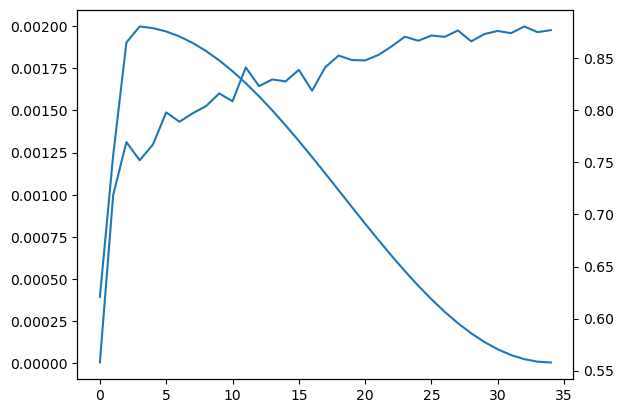

====== 1 ======


100%|██████████| 25/25 [00:02<00:00, 10.58it/s]


auc:0.7060
Validation loss decreased (inf --> -0.705984).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.01it/s]


auc:0.7170
Validation loss decreased (-0.705984 --> -0.716977).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.85it/s]


auc:0.7656
Validation loss decreased (-0.716977 --> -0.765578).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.41it/s]


auc:0.7777
Validation loss decreased (-0.765578 --> -0.777742).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.64it/s]


auc:0.8055
Validation loss decreased (-0.777742 --> -0.805517).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.76it/s]


auc:0.8140
Validation loss decreased (-0.805517 --> -0.814031).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.93it/s]


auc:0.7595
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.63it/s]


auc:0.8280
Validation loss decreased (-0.814031 --> -0.827957).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.85it/s]


auc:0.8427
Validation loss decreased (-0.827957 --> -0.842659).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.75it/s]


auc:0.8463
Validation loss decreased (-0.842659 --> -0.846314).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.27it/s]


auc:0.8550
Validation loss decreased (-0.846314 --> -0.854966).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.14it/s]


auc:0.8555
Validation loss decreased (-0.854966 --> -0.855475).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.57it/s]


auc:0.8380
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.30it/s]


auc:0.8523
EarlyStopping counter: 2 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.12it/s]


auc:0.8510
EarlyStopping counter: 3 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.82it/s]


auc:0.8511
EarlyStopping counter: 4 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.55it/s]


auc:0.8579
Validation loss decreased (-0.855475 --> -0.857949).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.92it/s]


auc:0.8578
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.75it/s]


auc:0.8659
Validation loss decreased (-0.857949 --> -0.865944).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.86it/s]


auc:0.8702
Validation loss decreased (-0.865944 --> -0.870157).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.61it/s]


auc:0.8748
Validation loss decreased (-0.870157 --> -0.874790).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.98it/s]


auc:0.8665
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.92it/s]


auc:0.8737
EarlyStopping counter: 2 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.64it/s]


auc:0.8763
Validation loss decreased (-0.874790 --> -0.876299).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.12it/s]


auc:0.8774
Validation loss decreased (-0.876299 --> -0.877356).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.50it/s]


auc:0.8781
Validation loss decreased (-0.877356 --> -0.878078).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.14it/s]


auc:0.8782
Validation loss decreased (-0.878078 --> -0.878173).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.94it/s]


auc:0.8823
Validation loss decreased (-0.878173 --> -0.882326).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.25it/s]


auc:0.8794
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.89it/s]


auc:0.8791
EarlyStopping counter: 2 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.70it/s]


auc:0.8807
EarlyStopping counter: 3 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.63it/s]


auc:0.8773
EarlyStopping counter: 4 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.05it/s]


auc:0.8811
EarlyStopping counter: 5 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.33it/s]


auc:0.8795
EarlyStopping counter: 6 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.34it/s]


auc:0.8789
EarlyStopping counter: 7 out of 50


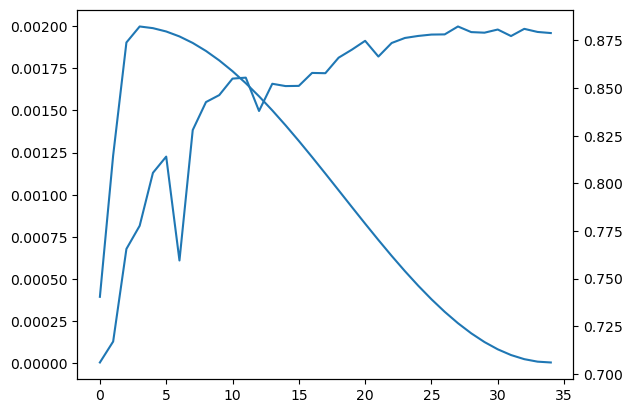

====== 2 ======


100%|██████████| 20/20 [00:01<00:00, 10.42it/s]


auc:0.8430
Validation loss decreased (inf --> -0.843040).  Saving model ...


100%|██████████| 20/20 [00:01<00:00, 11.16it/s]


auc:0.8739
Validation loss decreased (-0.843040 --> -0.873880).  Saving model ...


100%|██████████| 20/20 [00:01<00:00, 10.60it/s]


auc:0.8620
EarlyStopping counter: 1 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.66it/s]


auc:0.8671
EarlyStopping counter: 2 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.53it/s]


auc:0.8957
Validation loss decreased (-0.873880 --> -0.895729).  Saving model ...


100%|██████████| 20/20 [00:01<00:00, 11.17it/s]


auc:0.8966
Validation loss decreased (-0.895729 --> -0.896563).  Saving model ...


100%|██████████| 20/20 [00:01<00:00, 10.69it/s]


auc:0.8885
EarlyStopping counter: 1 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.97it/s]


auc:0.9124
Validation loss decreased (-0.896563 --> -0.912429).  Saving model ...


100%|██████████| 20/20 [00:01<00:00, 11.01it/s]


auc:0.9025
EarlyStopping counter: 1 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.68it/s]


auc:0.8971
EarlyStopping counter: 2 out of 50


100%|██████████| 20/20 [00:01<00:00, 11.24it/s]


auc:0.8856
EarlyStopping counter: 3 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.70it/s]


auc:0.9016
EarlyStopping counter: 4 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.92it/s]


auc:0.8957
EarlyStopping counter: 5 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.75it/s]


auc:0.9009
EarlyStopping counter: 6 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.60it/s]


auc:0.9035
EarlyStopping counter: 7 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.75it/s]


auc:0.9016
EarlyStopping counter: 8 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.81it/s]


auc:0.9063
EarlyStopping counter: 9 out of 50


100%|██████████| 20/20 [00:01<00:00, 11.04it/s]


auc:0.8922
EarlyStopping counter: 10 out of 50


100%|██████████| 20/20 [00:01<00:00, 11.01it/s]


auc:0.9152
Validation loss decreased (-0.912429 --> -0.915238).  Saving model ...


100%|██████████| 20/20 [00:01<00:00, 10.82it/s]


auc:0.9127
EarlyStopping counter: 1 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.94it/s]


auc:0.9053
EarlyStopping counter: 2 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.92it/s]


auc:0.8980
EarlyStopping counter: 3 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.57it/s]


auc:0.9109
EarlyStopping counter: 4 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.85it/s]


auc:0.9028
EarlyStopping counter: 5 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.91it/s]


auc:0.8974
EarlyStopping counter: 6 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.87it/s]


auc:0.8997
EarlyStopping counter: 7 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.96it/s]


auc:0.9003
EarlyStopping counter: 8 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.75it/s]


auc:0.9000
EarlyStopping counter: 9 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.91it/s]


auc:0.9037
EarlyStopping counter: 10 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.73it/s]


auc:0.9047
EarlyStopping counter: 11 out of 50


100%|██████████| 20/20 [00:01<00:00, 11.18it/s]


auc:0.9045
EarlyStopping counter: 12 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.72it/s]


auc:0.8979
EarlyStopping counter: 13 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.54it/s]


auc:0.8959
EarlyStopping counter: 14 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.93it/s]


auc:0.8985
EarlyStopping counter: 15 out of 50


100%|██████████| 20/20 [00:01<00:00, 10.28it/s]


auc:0.8993
EarlyStopping counter: 16 out of 50


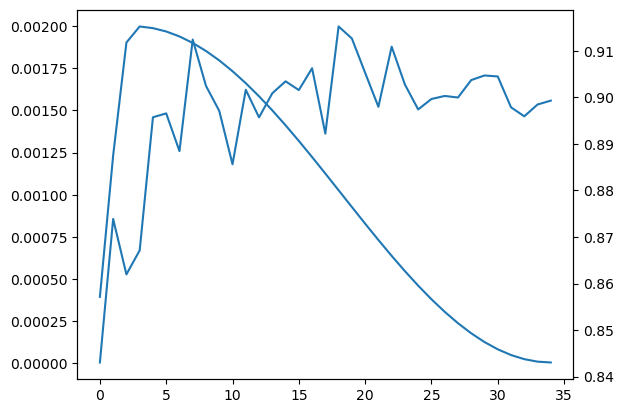

====== 3 ======


100%|██████████| 25/25 [00:02<00:00, 11.12it/s]


auc:0.8630
Validation loss decreased (inf --> -0.862971).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.75it/s]


auc:0.8866
Validation loss decreased (-0.862971 --> -0.886628).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.89it/s]


auc:0.8974
Validation loss decreased (-0.886628 --> -0.897390).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.65it/s]


auc:0.9189
Validation loss decreased (-0.897390 --> -0.918945).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.46it/s]


auc:0.9161
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.14it/s]


auc:0.9126
EarlyStopping counter: 2 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.85it/s]


auc:0.9057
EarlyStopping counter: 3 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.04it/s]


auc:0.9058
EarlyStopping counter: 4 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.24it/s]


auc:0.9117
EarlyStopping counter: 5 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.74it/s]


auc:0.9100
EarlyStopping counter: 6 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.62it/s]


auc:0.9060
EarlyStopping counter: 7 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.26it/s]


auc:0.9022
EarlyStopping counter: 8 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.23it/s]


auc:0.9138
EarlyStopping counter: 9 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.09it/s]


auc:0.9184
EarlyStopping counter: 10 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.89it/s]


auc:0.9197
Validation loss decreased (-0.918945 --> -0.919695).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.69it/s]


auc:0.9212
Validation loss decreased (-0.919695 --> -0.921218).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 11.04it/s]


auc:0.9191
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.85it/s]


auc:0.9330
Validation loss decreased (-0.921218 --> -0.933036).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.86it/s]


auc:0.9348
Validation loss decreased (-0.933036 --> -0.934815).  Saving model ...


100%|██████████| 25/25 [00:02<00:00, 10.88it/s]


auc:0.9290
EarlyStopping counter: 1 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.83it/s]


auc:0.9219
EarlyStopping counter: 2 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.28it/s]


auc:0.9222
EarlyStopping counter: 3 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.63it/s]


auc:0.9188
EarlyStopping counter: 4 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.66it/s]


auc:0.9251
EarlyStopping counter: 5 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.57it/s]


auc:0.9234
EarlyStopping counter: 6 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.63it/s]


auc:0.9256
EarlyStopping counter: 7 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.88it/s]


auc:0.9241
EarlyStopping counter: 8 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.80it/s]


auc:0.9271
EarlyStopping counter: 9 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.85it/s]


auc:0.9294
EarlyStopping counter: 10 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.79it/s]


auc:0.9269
EarlyStopping counter: 11 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.70it/s]


auc:0.9281
EarlyStopping counter: 12 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.61it/s]


auc:0.9250
EarlyStopping counter: 13 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.79it/s]


auc:0.9268
EarlyStopping counter: 14 out of 50


100%|██████████| 25/25 [00:02<00:00, 10.90it/s]


auc:0.9268
EarlyStopping counter: 15 out of 50


100%|██████████| 25/25 [00:02<00:00, 11.31it/s]


auc:0.9283
EarlyStopping counter: 16 out of 50


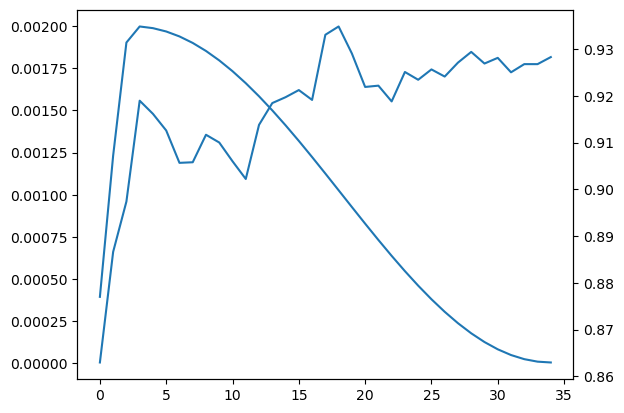

====== 4 ======


100%|██████████| 27/27 [00:02<00:00, 11.06it/s]


auc:0.7656
Validation loss decreased (inf --> -0.765559).  Saving model ...


100%|██████████| 27/27 [00:02<00:00, 10.80it/s]


auc:0.7532
EarlyStopping counter: 1 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.90it/s]


auc:0.8148
Validation loss decreased (-0.765559 --> -0.814764).  Saving model ...


100%|██████████| 27/27 [00:02<00:00, 10.93it/s]


auc:0.8416
Validation loss decreased (-0.814764 --> -0.841614).  Saving model ...


100%|██████████| 27/27 [00:02<00:00, 10.74it/s]


auc:0.8511
Validation loss decreased (-0.841614 --> -0.851146).  Saving model ...


100%|██████████| 27/27 [00:02<00:00, 10.87it/s]


auc:0.8842
Validation loss decreased (-0.851146 --> -0.884198).  Saving model ...


100%|██████████| 27/27 [00:02<00:00, 10.14it/s]


auc:0.8922
Validation loss decreased (-0.884198 --> -0.892243).  Saving model ...


100%|██████████| 27/27 [00:02<00:00, 10.37it/s]


auc:0.8931
Validation loss decreased (-0.892243 --> -0.893051).  Saving model ...


100%|██████████| 27/27 [00:02<00:00, 10.80it/s]


auc:0.9010
Validation loss decreased (-0.893051 --> -0.900952).  Saving model ...


100%|██████████| 27/27 [00:02<00:00, 10.30it/s]


auc:0.8954
EarlyStopping counter: 1 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.58it/s]


auc:0.8954
EarlyStopping counter: 2 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.69it/s]


auc:0.9044
Validation loss decreased (-0.900952 --> -0.904379).  Saving model ...


100%|██████████| 27/27 [00:02<00:00, 10.95it/s]


auc:0.9004
EarlyStopping counter: 1 out of 50


100%|██████████| 27/27 [00:02<00:00, 11.12it/s]


auc:0.9063
Validation loss decreased (-0.904379 --> -0.906258).  Saving model ...


100%|██████████| 27/27 [00:02<00:00, 10.81it/s]


auc:0.9002
EarlyStopping counter: 1 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.41it/s]


auc:0.9079
Validation loss decreased (-0.906258 --> -0.907935).  Saving model ...


100%|██████████| 27/27 [00:02<00:00, 10.65it/s]


auc:0.9040
EarlyStopping counter: 1 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.93it/s]


auc:0.9026
EarlyStopping counter: 2 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.52it/s]


auc:0.8991
EarlyStopping counter: 3 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.98it/s]


auc:0.8920
EarlyStopping counter: 4 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.64it/s]


auc:0.9019
EarlyStopping counter: 5 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.42it/s]


auc:0.9028
EarlyStopping counter: 6 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.88it/s]


auc:0.9013
EarlyStopping counter: 7 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.52it/s]


auc:0.9101
Validation loss decreased (-0.907935 --> -0.910140).  Saving model ...


100%|██████████| 27/27 [00:02<00:00, 10.87it/s]


auc:0.9037
EarlyStopping counter: 1 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.89it/s]


auc:0.8975
EarlyStopping counter: 2 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.37it/s]


auc:0.9050
EarlyStopping counter: 3 out of 50


100%|██████████| 27/27 [00:02<00:00, 11.17it/s]


auc:0.8999
EarlyStopping counter: 4 out of 50


100%|██████████| 27/27 [00:02<00:00, 11.02it/s]


auc:0.9012
EarlyStopping counter: 5 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.65it/s]


auc:0.9052
EarlyStopping counter: 6 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.75it/s]


auc:0.9014
EarlyStopping counter: 7 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.82it/s]


auc:0.9029
EarlyStopping counter: 8 out of 50


100%|██████████| 27/27 [00:02<00:00, 11.02it/s]


auc:0.9035
EarlyStopping counter: 9 out of 50


100%|██████████| 27/27 [00:02<00:00, 11.06it/s]


auc:0.9067
EarlyStopping counter: 10 out of 50


100%|██████████| 27/27 [00:02<00:00, 10.97it/s]


auc:0.9042
EarlyStopping counter: 11 out of 50


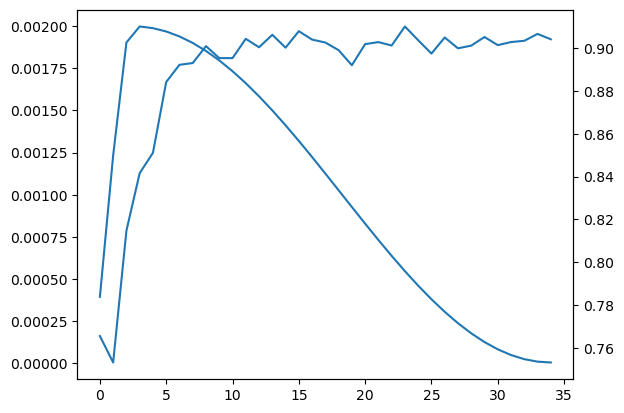

CPU times: user 3h 58min 29s, sys: 3h 42min 23s, total: 7h 40min 52s
Wall time: 7h 42min 19s


In [19]:
%%time
if is_train:
    for fold in range(0, 5):
        print(f"====== {fold} ======")

        net = Unet()
        net.to(device)

        base_optimizer = optim.AdamW
        optimizer = SAM(
            net.parameters(), base_optimizer, lr=Config.LR, weight_decay=1.0e-02
        )

        train_dataset = CVDataSet(
            data_set[fold]["train_img"],
            get_augmentation(),
            labels=data_set[fold]["train_label"],
            data_type="train",
            crop_size=Config.IMG_SIZE,
        )
        trainloader = DataLoader(
            train_dataset,
            batch_size=Config.BATCH_SIZE,
            pin_memory=True,
            shuffle=True,
            drop_last=True,
            num_workers=Config.NUM_WORKERS,
        )

        train_dataset_ir = CVDataSet(
            data_set[fold]["train_img"],
            get_augmentation(),
            labels=data_set[fold]["train_ir"],
            data_type="train",
            crop_size=Config.IMG_SIZE,
        )
        trainloader_ir = DataLoader(
            train_dataset_ir,
            batch_size=Config.BATCH_SIZE,
            pin_memory=True,
            shuffle=True,
            drop_last=True,
            num_workers=Config.NUM_WORKERS,
        )

        
        valid_dataloaders = []

        for j in range(Config.PREDICT_STRIDE):

            valid_dataset = CVDataSet(
                [
                    data_set[fold]["valid_img"][0][
                        :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ]
                ],
                get_test_augmentation(),
                labels=[
                    data_set[fold]["valid_label"][0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ]
                ],
                data_type="valid",
                crop_size=Config.IMG_SIZE,
            )

            validloader = DataLoader(
                valid_dataset,
                batch_size=Config.BATCH_SIZE,
                pin_memory=True,
                num_workers=Config.NUM_WORKERS,
            )
            valid_dataloaders.append(validloader)

        early_stopping = EarlyStopping(
            patience=Config.PATIENCE, verbose=True, fold=fold
        )

        scheduler = torch.optim.lr_scheduler.OneCycleLR(
            optimizer,
            epochs=Config.EPOCH,
            steps_per_epoch=len(trainloader),
            max_lr=Config.MAX_LR,
            pct_start=0.1,
            anneal_strategy="cos",
            div_factor=1.0e2,
            final_div_factor=5,
        )

        val_metrics = []
        learning_rates = []

        for epoch in range(Config.EPOCH):

            running_loss = 0.0
            train_rmse_list = []
            
            if epoch < 20:
                loader = trainloader_ir
            else:
                loader = trainloader
        
            n_iter = len(loader)
            with tqdm(enumerate(loader), total=n_iter) as pbar:
                #! ADD CLASS
                for i, (img, target_mask, target_class) in pbar:

                    net.train()
                    #! ADD CLASS                    
                    img, target_mask, target_class = img.to(device).float(), target_mask.to(device).float(), target_class.to(device).float().view(-1,1)
                    outputs_mask, outputs_class = net(img)
                    loss = criterion(outputs_class, target_class, outputs_mask.squeeze(), target_mask)
                    
                    loss.backward()  # Backward pass
                    optimizer.first_step(zero_grad=True)

                    outputs_mask, outputs_class = net(img)
                    criterion(outputs_class, target_class, outputs_mask.squeeze(), target_mask).backward()

                    optimizer.second_step(zero_grad=True)
                    net.zero_grad()

                    # print statistics
                    running_loss += loss.item()

                    outputs_np = outputs_mask.to("cpu").detach().numpy().copy()

                    pbar.set_postfix(
                        OrderedDict(
                            epoch="{:>10}".format(epoch),
                            loss="{:.4f}".format(loss.item()),
                        )
                    )
                    scheduler.step()

            pred_tile_imgs = []
            for j, validloader in enumerate(valid_dataloaders):

                ## shift test
                val_preds = []
                val_class = []
                valid_targets = []
                
                n_iter_val = len(validloader)
                #! ADD CLASS
                for i, (img, target_mask, target_class) in tqdm(
                    enumerate(validloader), total=n_iter_val, smoothing=0
                ):
                    net.eval()

                    with torch.no_grad():
                        #! ADD CLASS
                        img, target_mask, target_class = (
                                        img.to(device).float(),
                                        target_mask.to(device).float(),
                                        target_class.to(device).float().view(-1,1),
                                    )
                        outputs_mask, outputs_class  = net(img)
                        outputs_mask = outputs_mask.sigmoid()
                        
                        outputs_np = outputs_mask.to("cpu").detach().numpy().copy()
                        outputs_class = outputs_class.detach().cpu().numpy().ravel().tolist()
                        
                        val_preds.append(outputs_np)
                        val_class.append(outputs_class)
                        valid_targets.append(target_mask.to("cpu").detach().numpy().copy())

                ## 端を切る
                w_count = math.ceil(
                    data_set[fold]["valid_label"][0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ].shape[1]
                    / Config.IMG_SIZE
                )
                h_count = math.ceil(
                    data_set[fold]["valid_label"][0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ].shape[0]
                    / Config.IMG_SIZE
                )

                tile_arry = []
                stack_pred = np.vstack(val_preds).reshape(
                    -1, Config.IMG_SIZE, Config.IMG_SIZE
                )
                for h_i in range(h_count):
                    tile_arry.append(stack_pred[h_i * w_count : (h_i + 1) * w_count])

                _pred_tile_img = concat_tile(tile_arry)
                _pred_tile_img = np.where(
                    data_set[fold]["valid_mask"][0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ]
                    > 1,
                    _pred_tile_img[
                        : data_set[fold]["valid_label"][0][
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        ].shape[0],
                        : data_set[fold]["valid_label"][0][
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        ].shape[1],
                    ],
                    0,
                )

                shift_pred_tile_img = np.zeros(
                    (
                        data_set[fold]["valid_img"][0].shape[1],
                        data_set[fold]["valid_img"][0].shape[2],
                    )
                )
                shift_pred_tile_img[
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                ] = _pred_tile_img

                # plt.imshow(shift_pred_tile_img)
                # plt.show()

                pred_tile_imgs.append(shift_pred_tile_img)

            pred_tile_img = np.sum(pred_tile_imgs, axis=0) / (Config.PREDICT_STRIDE)

            auc = roc_auc_score(
                data_set[fold]["valid_label"][0].reshape(-1),
                pred_tile_img.reshape(-1),
            )

#             logger.info("auc:{:.4f}".format(auc))
            print("auc:{:.4f}".format(auc))

            lr = optimizer.param_groups[0]["lr"]

            val_metrics.append(auc)
            learning_rates.append(lr)

            early_stopping(-auc, net)

            if early_stopping.early_stop:
                print("Early stopping")
#                 logger.info("Early stopping")
                break

        fig = plt.figure()
        ax1 = fig.add_subplot(111)
        ax1.plot(learning_rates)
        ax2 = ax1.twinx()
        ax2.plot(val_metrics)
        plt.show()

        del (
            net,
            validloader,
            trainloader,
            train_dataset,
            valid_dataset,
            img,
            target_mask,
            target_class,
            outputs_mask,
            outputs_class,
        )
        torch.cuda.empty_cache()
        gc.collect()
        

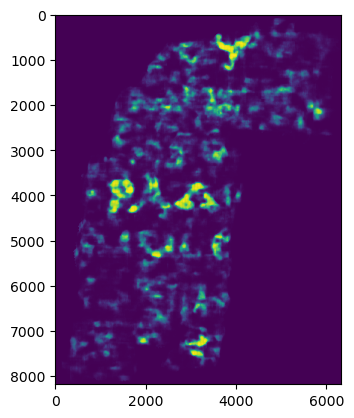

In [20]:
plt.imshow(pred_tile_img)

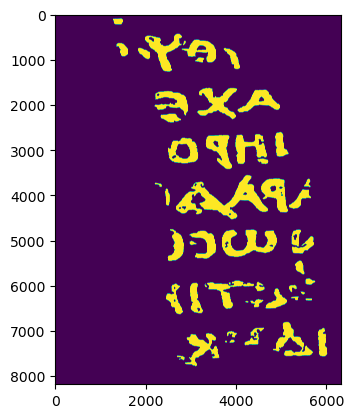

In [21]:
plt.imshow(np.flip(data_set[fold]["valid_label"][0], 1))

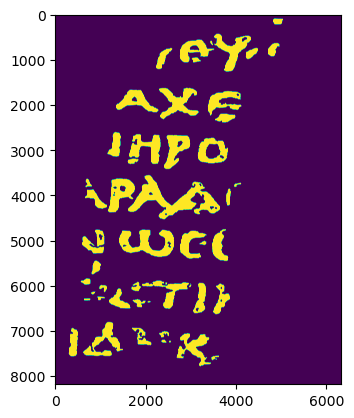

In [22]:
plt.imshow(data_set[fold]["valid_label"][0])

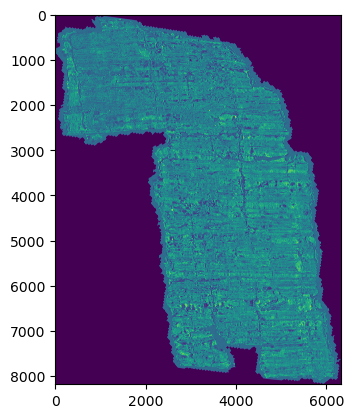

In [23]:
plt.imshow(np.flip(data_set[fold]["valid_img"][0], 2)[0])

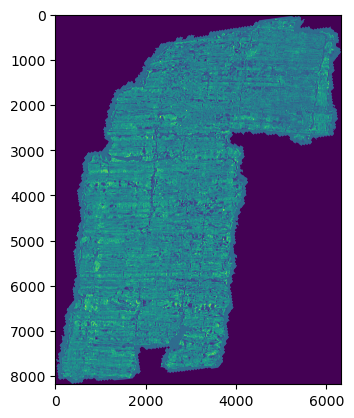

In [24]:
plt.imshow(data_set[fold]["valid_img"][0][0])

# valid

====== 0 ======


100%|██████████| 25/25 [00:02<00:00, 10.70it/s]


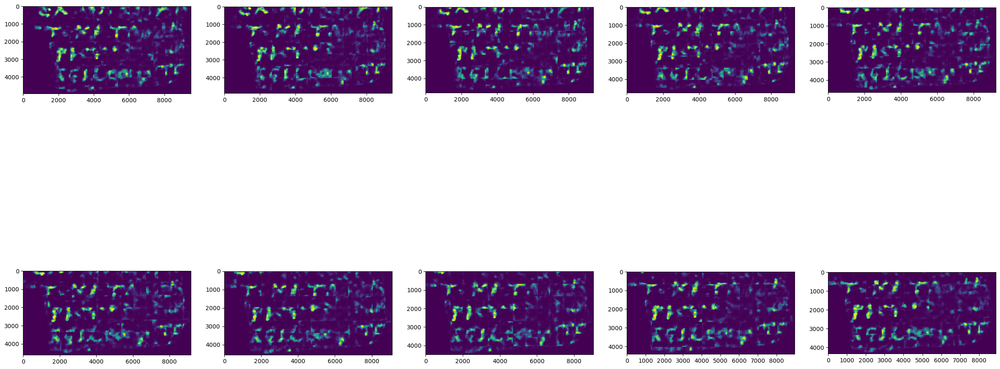

100%|██████████| 25/25 [00:02<00:00, 10.86it/s]


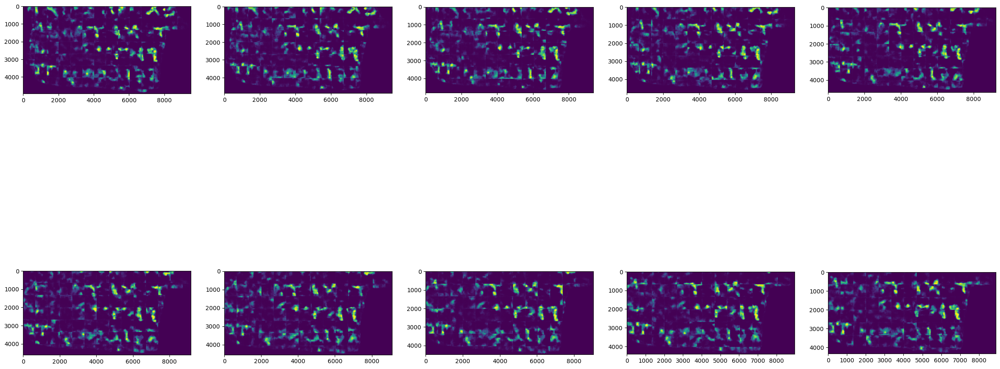

100%|██████████| 25/25 [00:02<00:00,  9.97it/s]


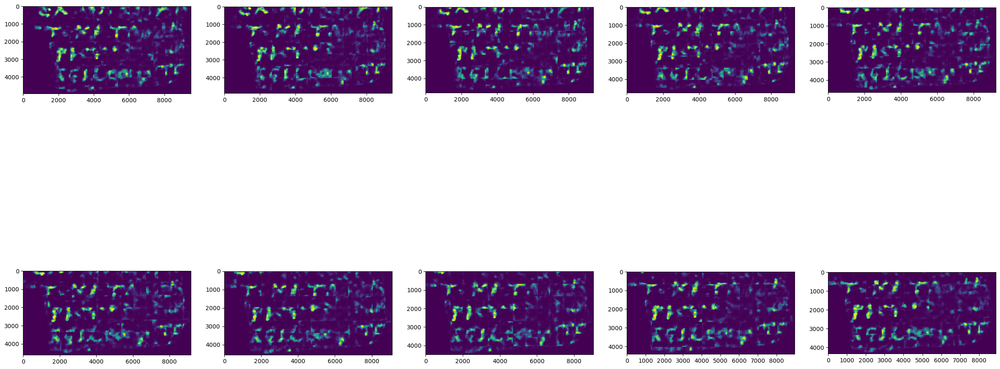

100%|██████████| 25/25 [00:02<00:00,  8.96it/s]


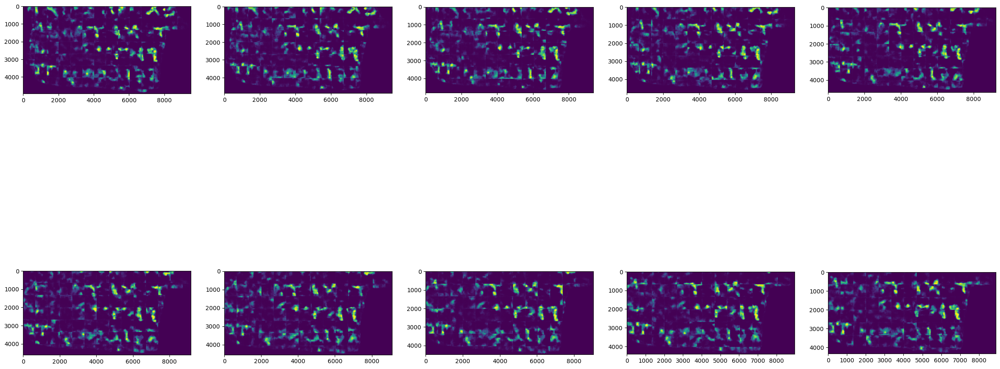

100%|██████████| 25/25 [00:03<00:00,  7.97it/s]


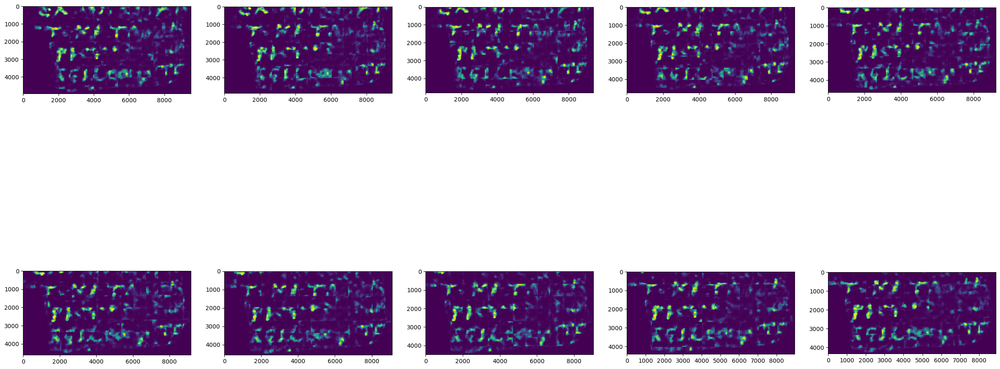

100%|██████████| 25/25 [00:03<00:00,  7.21it/s]


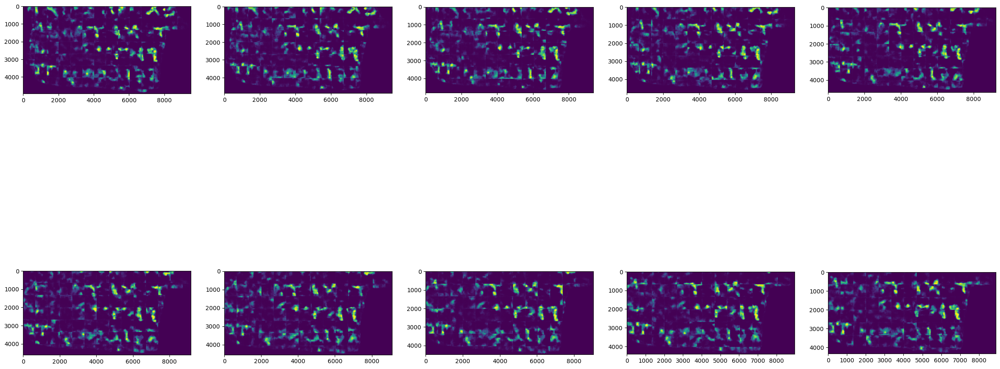

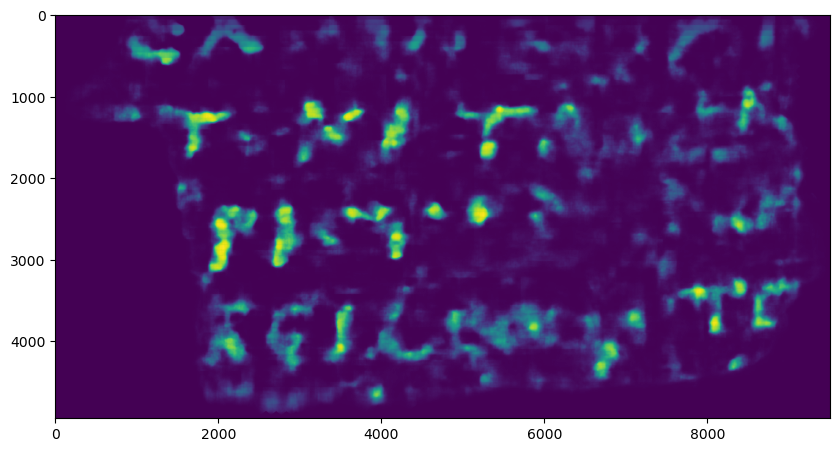

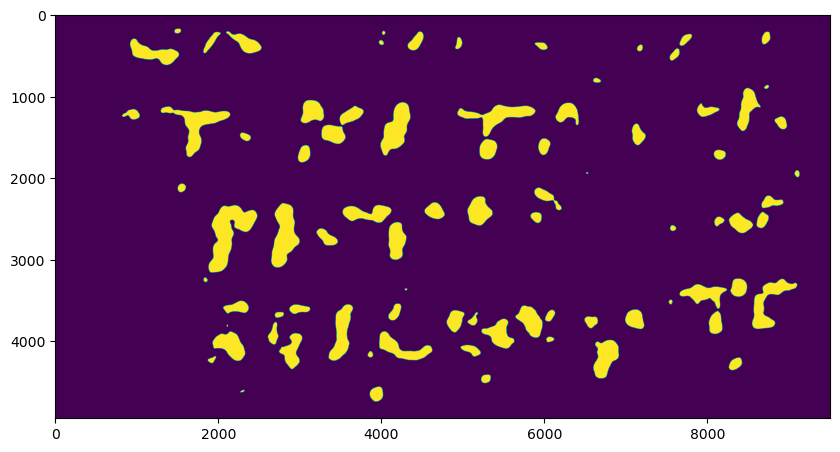

0.8833459662834398
====== 1 ======


100%|██████████| 25/25 [00:04<00:00,  5.85it/s]


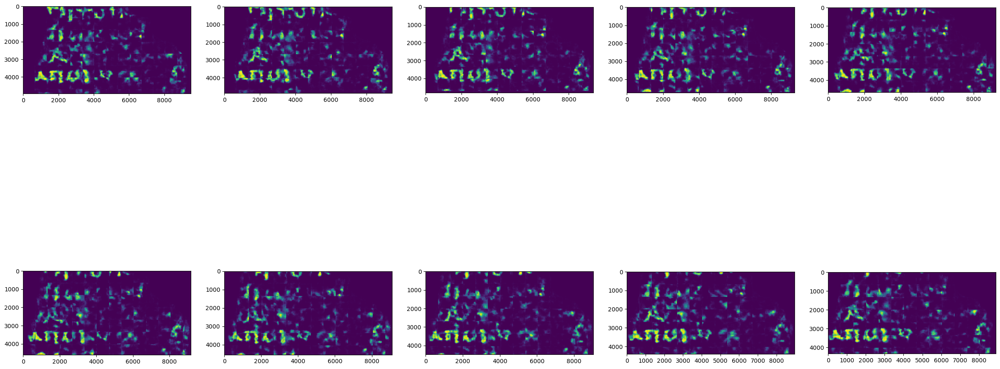

100%|██████████| 25/25 [00:04<00:00,  5.72it/s]


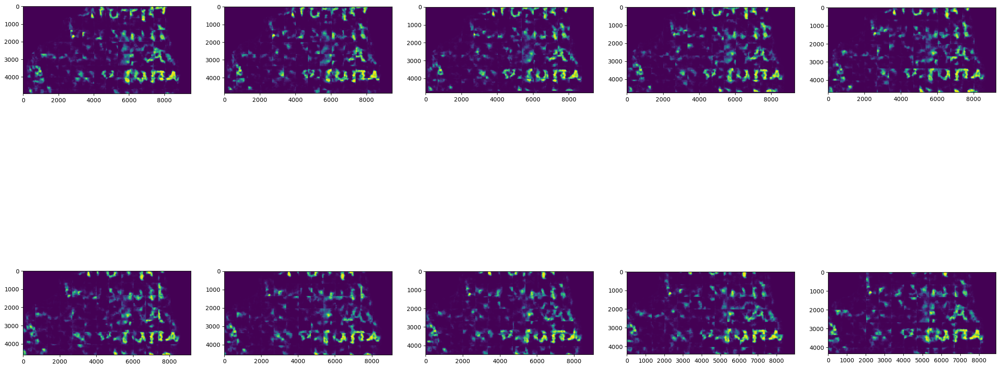

100%|██████████| 25/25 [00:04<00:00,  5.85it/s]


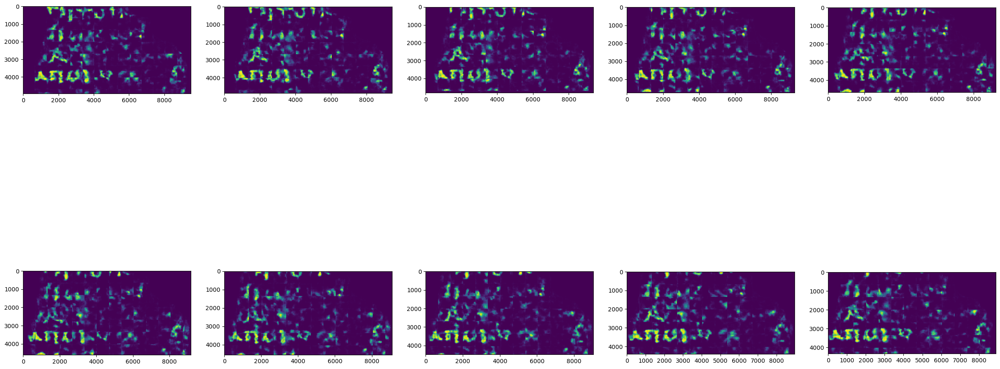

100%|██████████| 25/25 [00:04<00:00,  5.70it/s]


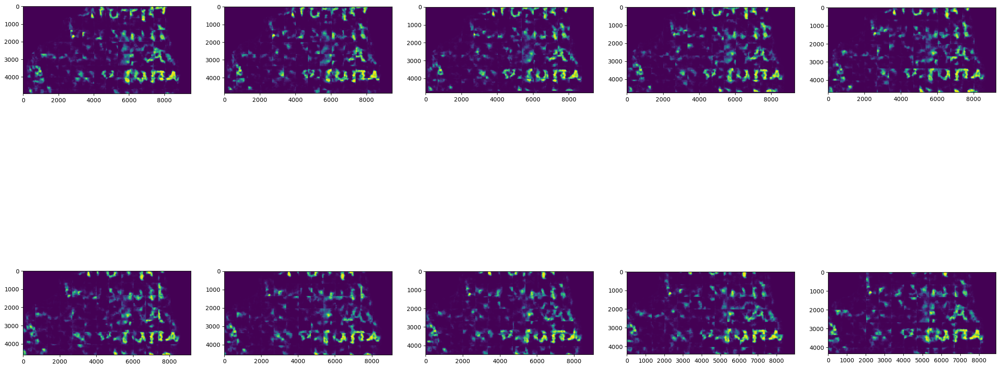

100%|██████████| 25/25 [00:04<00:00,  5.87it/s]


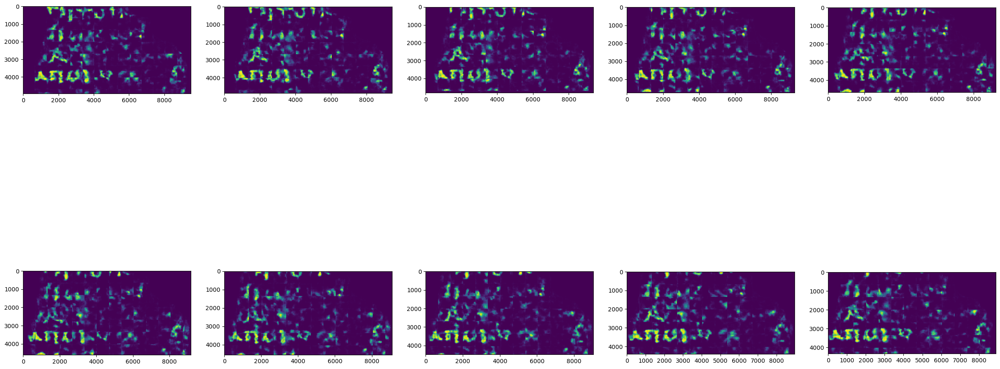

100%|██████████| 25/25 [00:04<00:00,  5.73it/s]


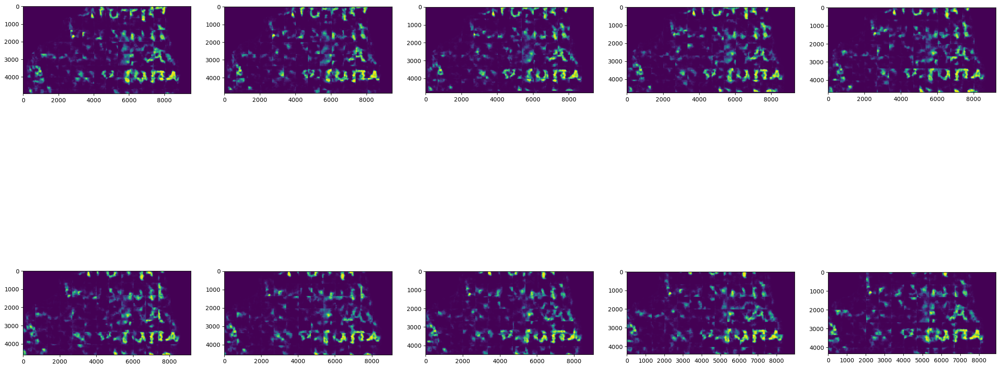

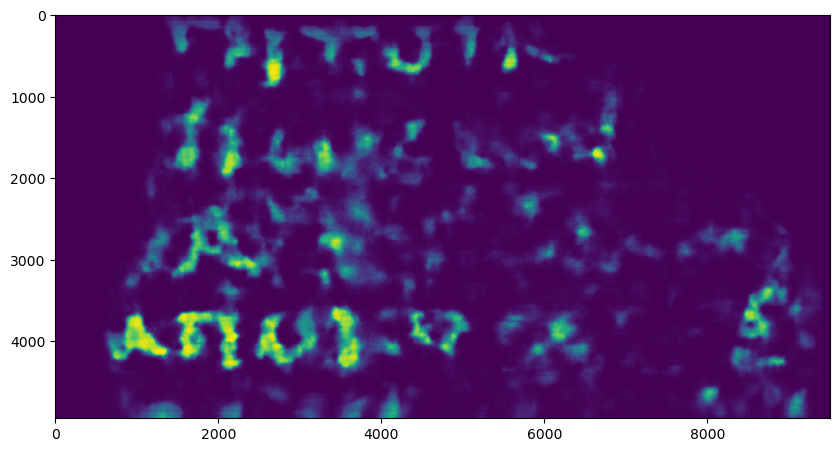

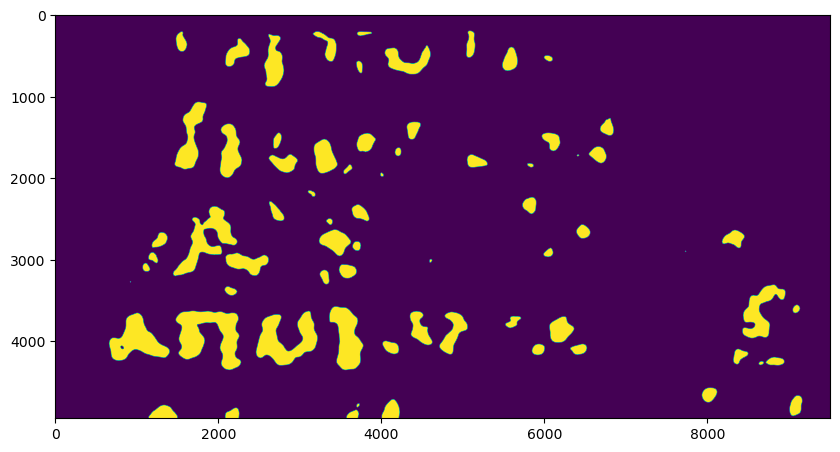

0.8855948591889271
====== 2 ======


100%|██████████| 20/20 [00:03<00:00,  5.30it/s]


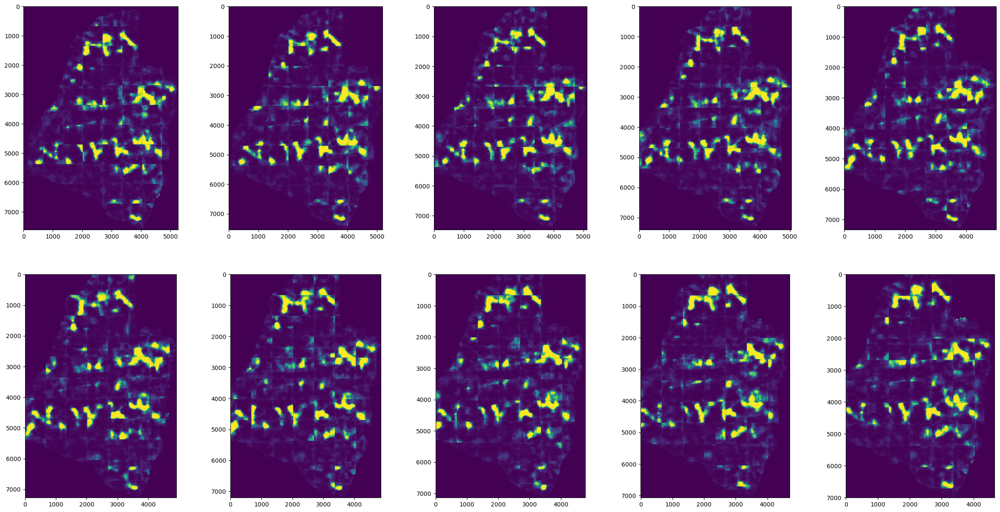

100%|██████████| 20/20 [00:03<00:00,  5.13it/s]


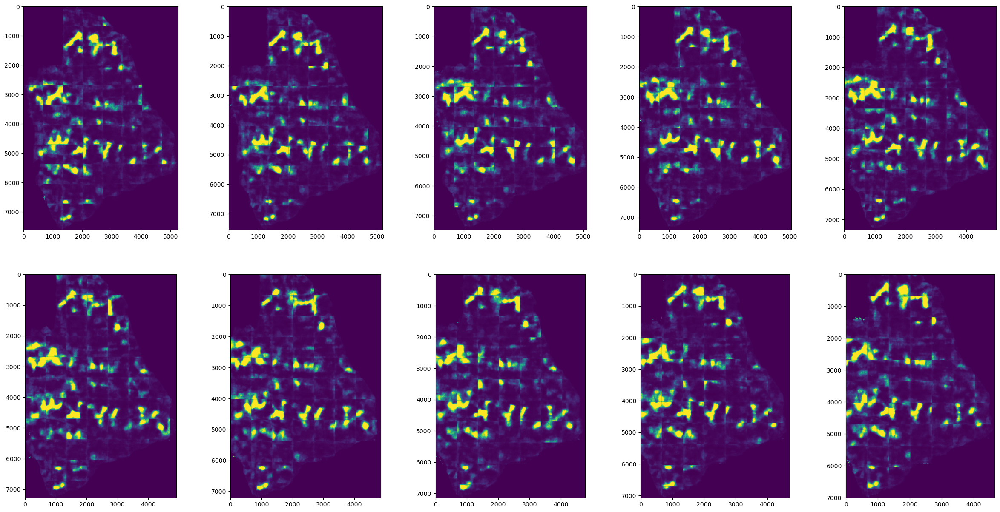

100%|██████████| 20/20 [00:03<00:00,  5.15it/s]


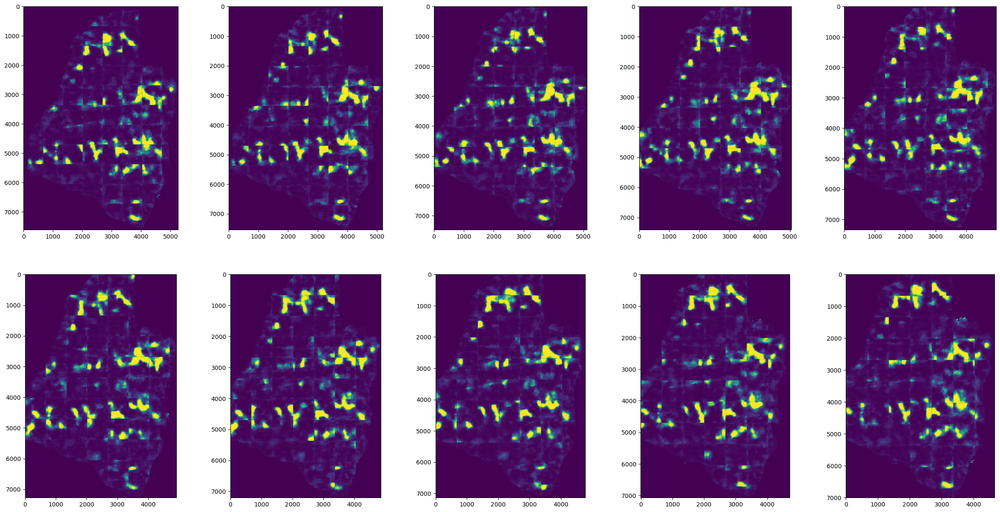

100%|██████████| 20/20 [00:03<00:00,  5.03it/s]


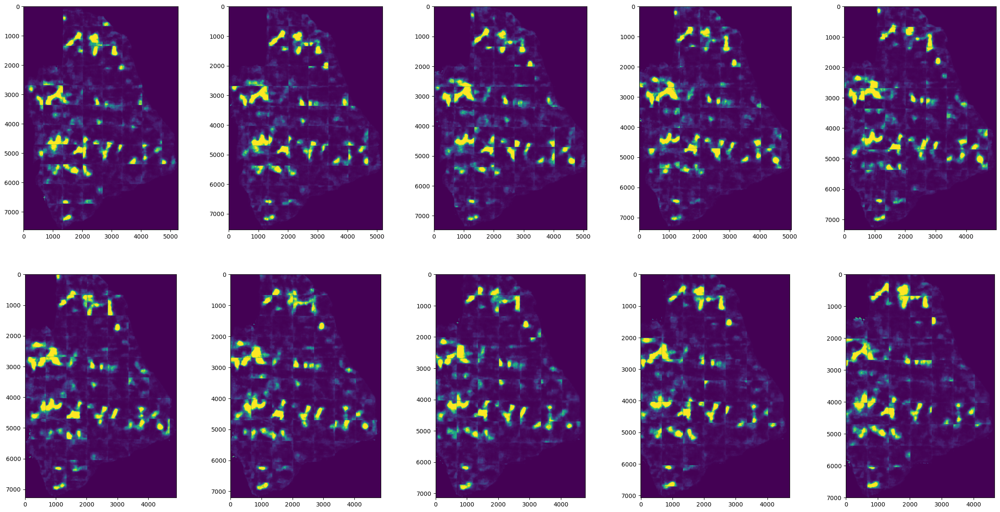

100%|██████████| 20/20 [00:03<00:00,  5.29it/s]


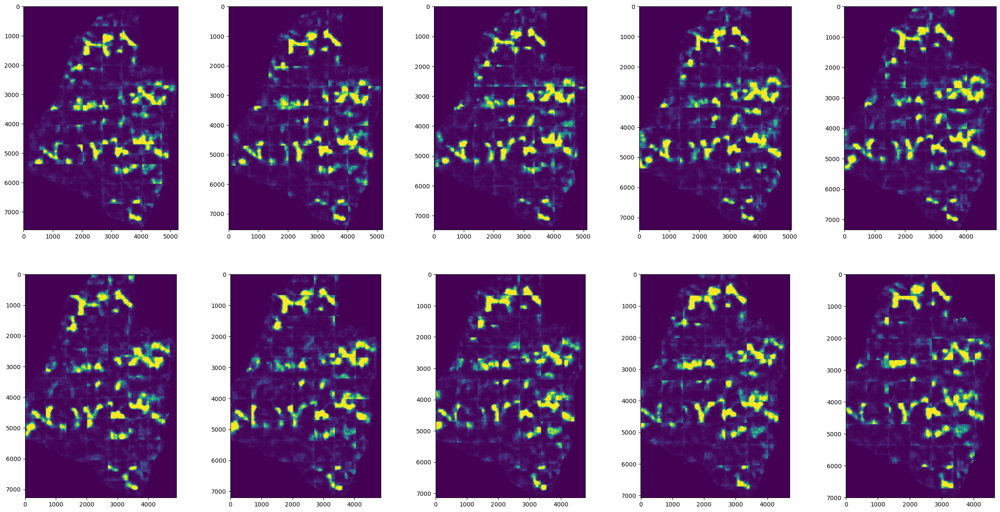

100%|██████████| 20/20 [00:03<00:00,  5.17it/s]


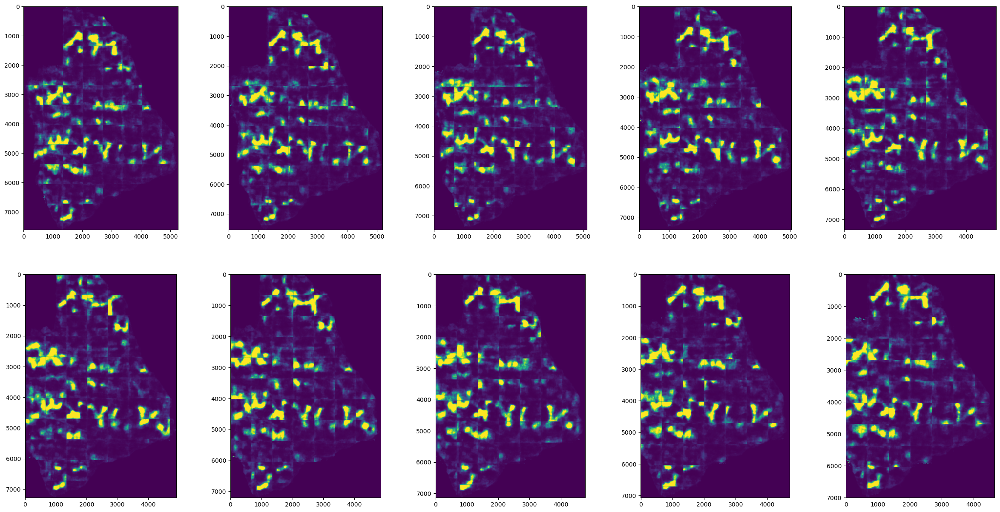

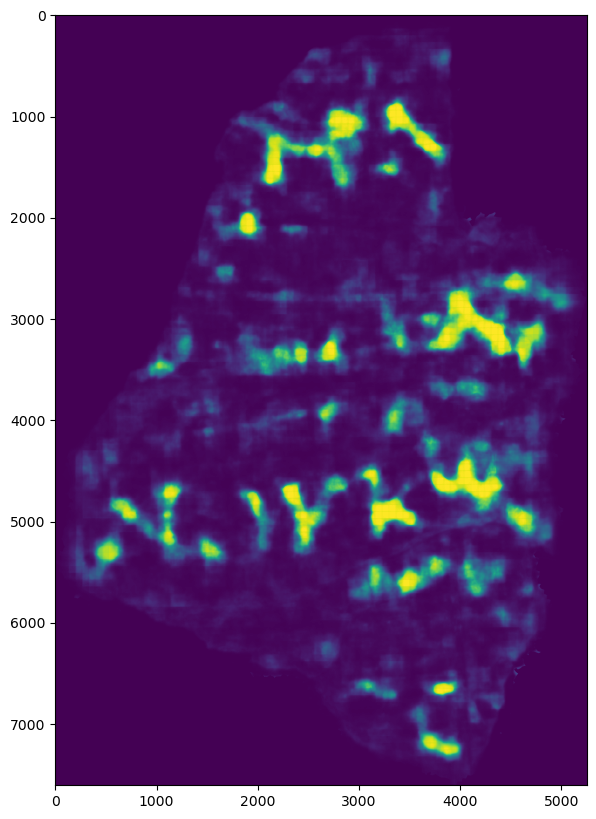

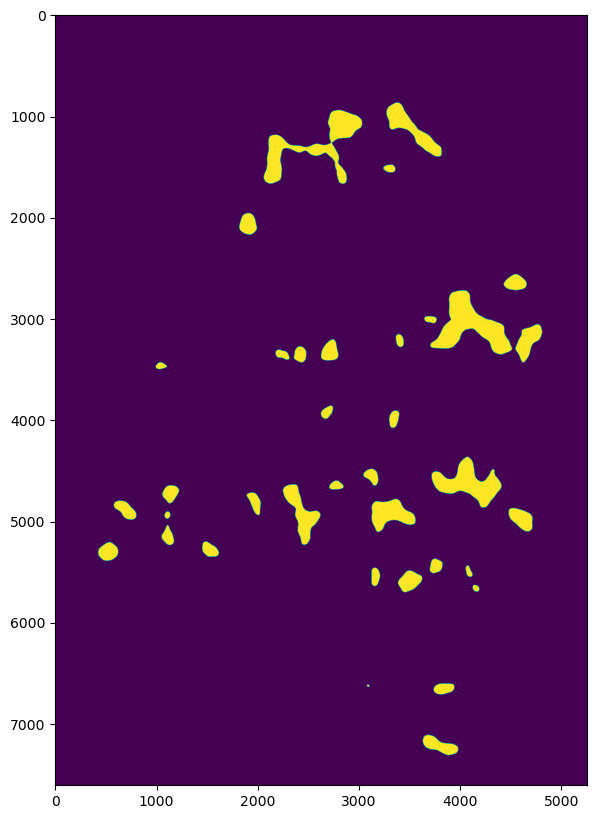

0.918690820714533
====== 3 ======


100%|██████████| 25/25 [00:04<00:00,  5.78it/s]


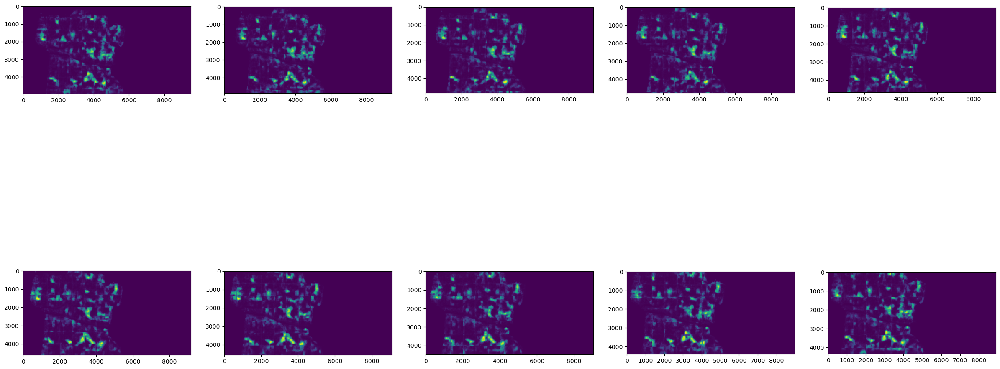

100%|██████████| 25/25 [00:04<00:00,  5.73it/s]


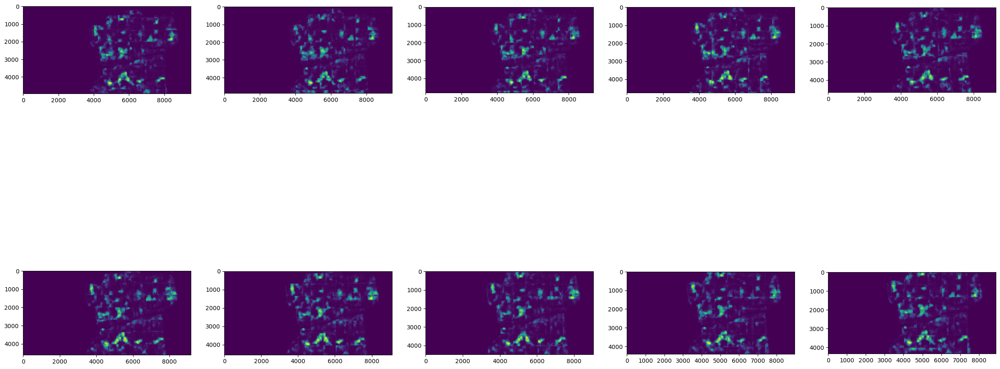

100%|██████████| 25/25 [00:04<00:00,  5.47it/s]


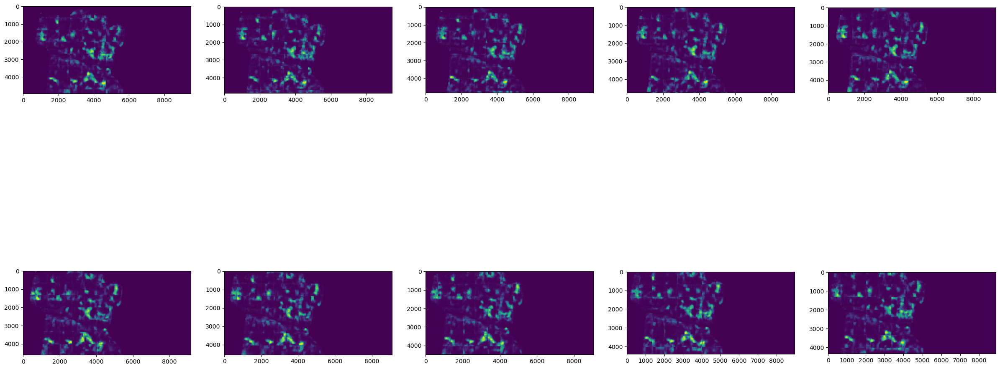

100%|██████████| 25/25 [00:04<00:00,  5.67it/s]


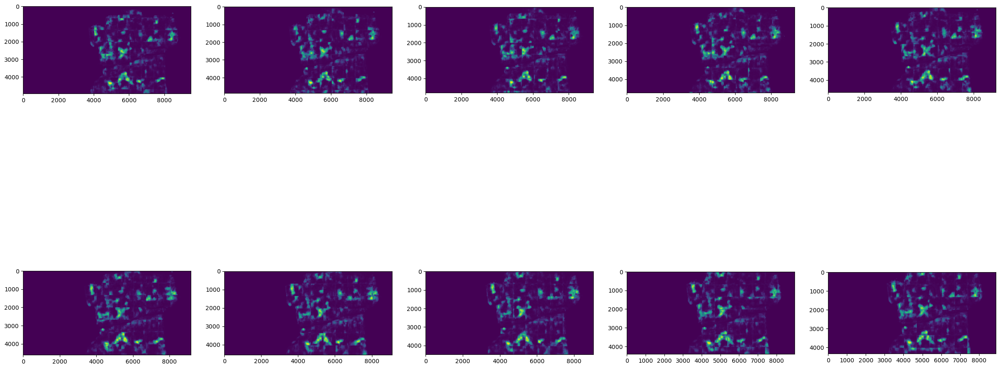

100%|██████████| 25/25 [00:04<00:00,  5.66it/s]


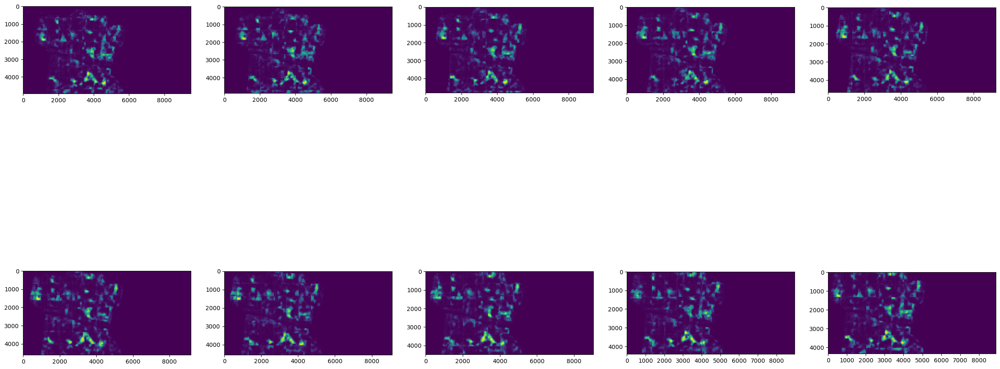

100%|██████████| 25/25 [00:04<00:00,  5.65it/s]


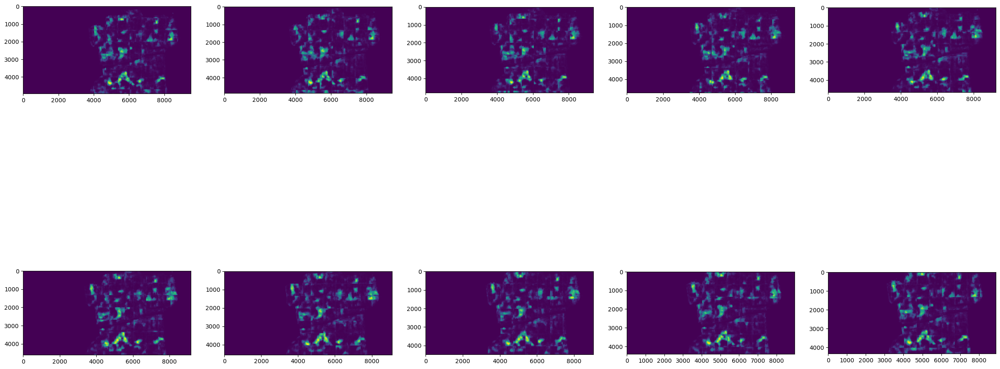

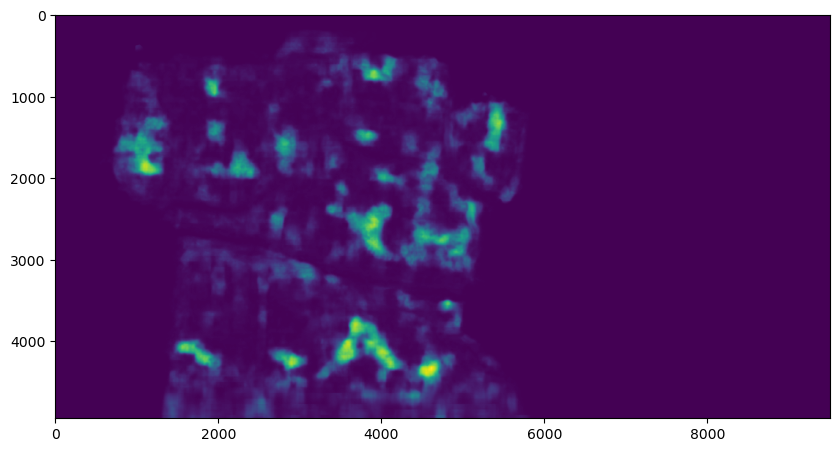

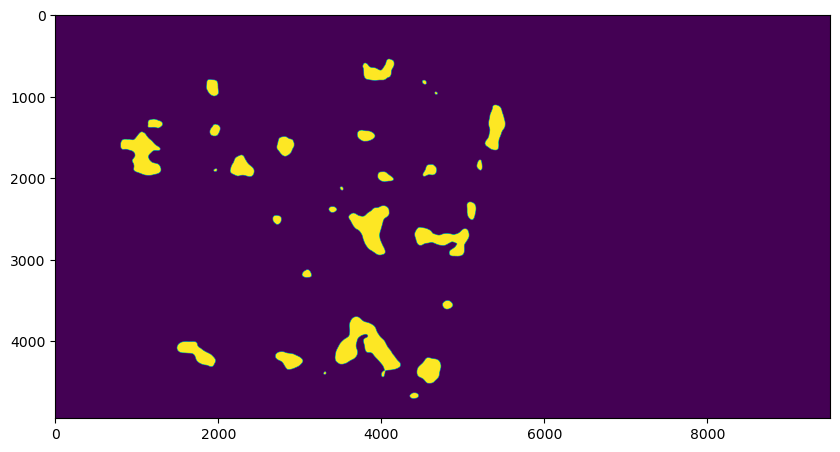

0.9361247662958502
====== 4 ======


100%|██████████| 27/27 [00:04<00:00,  5.91it/s]


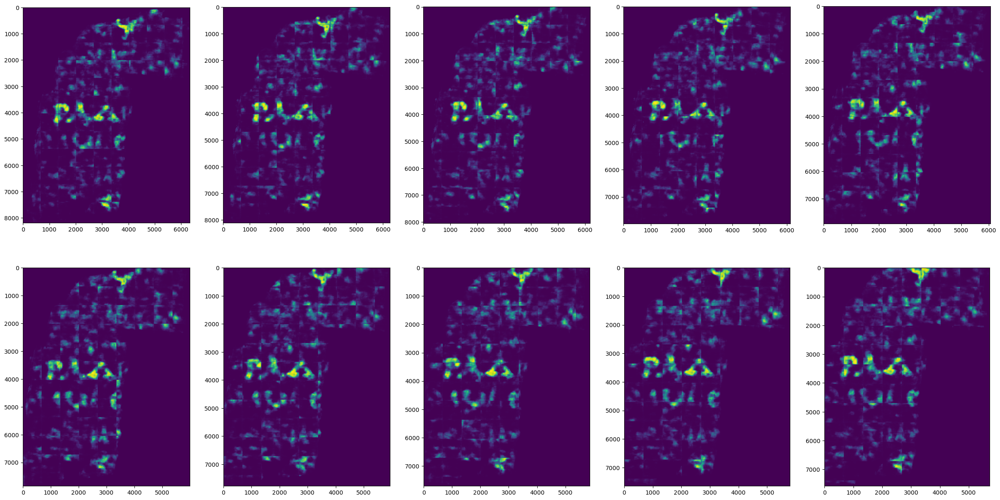

100%|██████████| 27/27 [00:04<00:00,  5.40it/s]


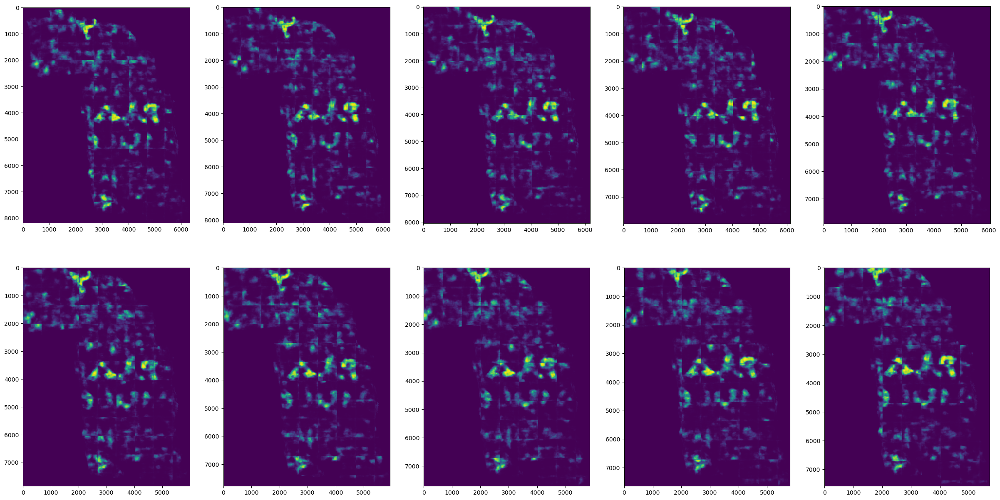

100%|██████████| 27/27 [00:04<00:00,  5.67it/s]


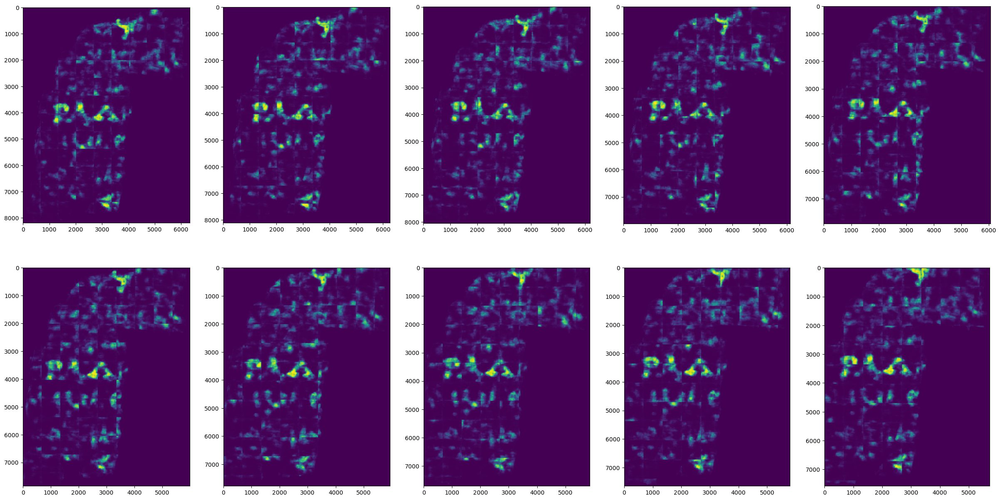

100%|██████████| 27/27 [00:04<00:00,  5.67it/s]


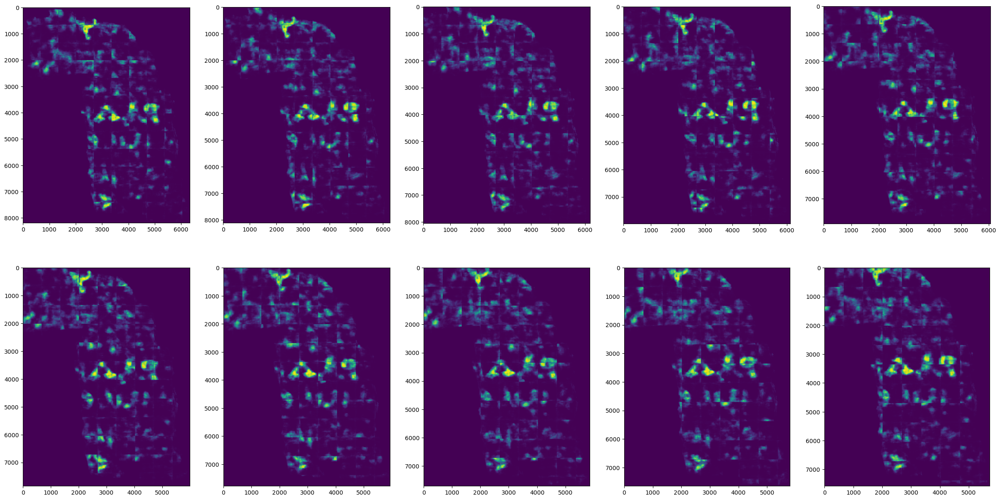

100%|██████████| 27/27 [00:04<00:00,  5.83it/s]


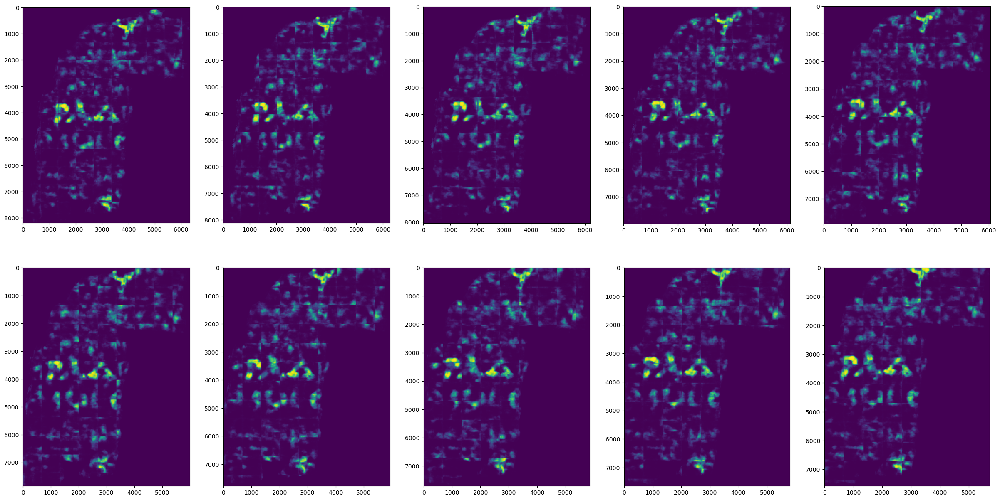

100%|██████████| 27/27 [00:05<00:00,  5.26it/s]


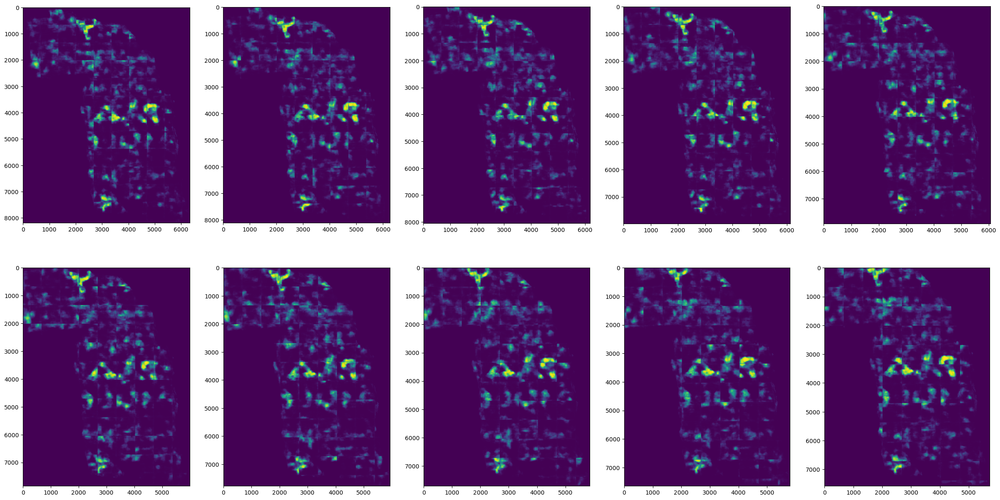

: 

: 

In [25]:
%%time
if is_train:
    all_preds = []
    all_masks = []
    aucs = {}
    for fold in range(0, 5):
        # for fold in [0, 2]:
        print(f"====== {fold} ======")

        net = Unet()
        net.load_state_dict(torch.load(OUTPUT_DIR/ f"{EXP_NAME}_{fold}.pt"))
        net.to(device)

        img_idx_nums = []
        for img_idx_num in range(3):

            valid_dataloaders = []

            for j in range(Config.PREDICT_STRIDE):

                valid_dataset = CVDataSet(
                    [
                        data_set[fold]["valid_img"][img_idx_num][
                            :,
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        ]
                    ],
                    get_test_augmentation(),
                    labels=[
                        data_set[fold]["valid_label"][0][
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        ]
                    ],
                    data_type="valid",
                    crop_size=Config.IMG_SIZE,
                )

                validloader = DataLoader(
                    valid_dataset,
                    batch_size=Config.BATCH_SIZE,
                    pin_memory=True,
                    num_workers=Config.NUM_WORKERS,
                )
                valid_dataloaders.append(validloader)

            h_flip_valid_dataloaders = []

            for j in range(Config.PREDICT_STRIDE):

                valid_dataset = CVDataSet(
                    [
                        np.flip(data_set[fold]["valid_img"][img_idx_num], 2)[
                            :,
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        ]
                    ],
                    get_test_augmentation(),
                    labels=[
                        np.flip(data_set[fold]["valid_label"][0], 1)[
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        ]
                    ],
                    data_type="valid",
                    crop_size=Config.IMG_SIZE,
                )

                validloader = DataLoader(
                    valid_dataset,
                    batch_size=Config.BATCH_SIZE,
                    pin_memory=True,
                    num_workers=Config.NUM_WORKERS,
                )
                h_flip_valid_dataloaders.append(validloader)

            fig, axes = plt.subplots(
                2, math.ceil(Config.PREDICT_STRIDE / 2), figsize=(30, 15)
            )
            axes = axes.reshape(-1)
            pred_tile_imgs = []

            for j, validloader in enumerate(valid_dataloaders):
                ## shift test
                val_preds = []
                val_class = []
                valid_targets = []
                valid_targets_class = []
                n_iter_val = len(validloader)
                for i, (img, target_mask, target_class) in tqdm(
                    enumerate(validloader), total=n_iter_val, smoothing=0
                    ):
                    net.eval()
                    with torch.no_grad():
                        img, target_mask, target_class = (
                            img.to(device).float(),
                            target_mask.to(device).float(),
                            target_class.to(device).float(),
                        )
                        outputs_mask, outputs_class = net(img)
                        outputs_mask = outputs_mask.sigmoid()
                        outputs_np = outputs_mask.to("cpu").detach().numpy().copy()
                        outputs_class = outputs_class.detach().cpu().numpy().ravel()
                        
                        val_preds.append(outputs_np)
                        val_class.append(outputs_class)
                        valid_targets.append(target_mask.to("cpu").detach().numpy().copy())
                        valid_targets_class.append(target_class.to("cpu").detach().numpy().copy()) 

                ## 端を切る
                w_count = math.ceil(
                    data_set[fold]["valid_label"][0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ].shape[1]
                    / Config.IMG_SIZE
                )
                h_count = math.ceil(
                    data_set[fold]["valid_label"][0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ].shape[0]
                    / Config.IMG_SIZE
                )

                tile_arry = []
                stack_pred = np.vstack(val_preds).reshape(
                    -1, Config.IMG_SIZE, Config.IMG_SIZE
                )
                for h_i in range(h_count):
                    tile_arry.append(stack_pred[h_i * w_count : (h_i + 1) * w_count])

                _pred_tile_img = concat_tile(tile_arry)
                _pred_tile_img = np.where(
                    data_set[fold]["valid_mask"][0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ]
                    > 1,
                    _pred_tile_img[
                        : data_set[fold]["valid_label"][0][
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        ].shape[0],
                        : data_set[fold]["valid_label"][0][
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        ].shape[1],
                    ],
                    0,
                )

                axes[j].imshow(_pred_tile_img)

                shift_pred_tile_img = np.zeros(
                    (
                        data_set[fold]["valid_img"][0].shape[1],
                        data_set[fold]["valid_img"][0].shape[2],
                    )
                )
                shift_pred_tile_img[
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                ] = _pred_tile_img

                pred_tile_imgs.append(shift_pred_tile_img)

            plt.show()

            pred_tile_img_idx = np.sum(pred_tile_imgs, axis=0) / Config.PREDICT_STRIDE
            img_idx_nums.append(pred_tile_img_idx)

            # ここから HFLIP

            fig, axes = plt.subplots(
                2, math.ceil(Config.PREDICT_STRIDE / 2), figsize=(30, 15)
            )
            axes = axes.reshape(-1)
            pred_tile_imgs = []

            for j, validloader in enumerate(h_flip_valid_dataloaders):
                val_preds = []
                val_class = []
                valid_targets = []
                valid_targets_class = []
                n_iter_val = len(validloader)
                for i, (img, target_mask, target_class) in tqdm(enumerate(validloader), total=n_iter_val, smoothing=0):
                    net.eval()
                    with torch.no_grad():
                        img, target_mask, target_class = (img.to(device).float(),
                                                            target_mask.to(device).float(),
                                                            target_class.to(device).float(),
                                                        )
                        outputs_mask, outputs_class = net(img)
                        outputs_mask = outputs_mask.sigmoid()
                        outputs_np = outputs_mask.to("cpu").detach().numpy().copy()
                        outputs_class = outputs_class.detach().cpu().numpy().ravel()
                        
                        val_preds.append(outputs_np)
                        val_class.append(outputs_class)
                        valid_targets.append(target_mask.to("cpu").detach().numpy().copy())
                        valid_targets_class.append(target_class.to("cpu").detach().numpy().copy())

                ## 端を切る
                w_count = math.ceil(
                    data_set[fold]["valid_label"][0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ].shape[1]
                    / Config.IMG_SIZE
                )
                h_count = math.ceil(
                    data_set[fold]["valid_label"][0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ].shape[0]
                    / Config.IMG_SIZE
                )

                tile_arry = []
                stack_pred = np.vstack(val_preds).reshape(
                    -1, Config.IMG_SIZE, Config.IMG_SIZE
                )
                for h_i in range(h_count):
                    tile_arry.append(stack_pred[h_i * w_count : (h_i + 1) * w_count])

                _pred_tile_img = concat_tile(tile_arry)
                _pred_tile_img = np.where(
                    np.flip(data_set[fold]["valid_mask"][0], 1)[
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ]
                    > 1,
                    _pred_tile_img[
                        : data_set[fold]["valid_label"][0][
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        ].shape[0],
                        : data_set[fold]["valid_label"][0][
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                            (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        ].shape[1],
                    ],
                    0,
                )

                axes[j].imshow(_pred_tile_img)

                shift_pred_tile_img = np.zeros(
                    (
                        data_set[fold]["valid_img"][0].shape[1],
                        data_set[fold]["valid_img"][0].shape[2],
                    )
                )
                shift_pred_tile_img[
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                ] = _pred_tile_img

                pred_tile_imgs.append(shift_pred_tile_img)

            plt.show()

            pred_tile_img_idx = np.sum(pred_tile_imgs, axis=0) / Config.PREDICT_STRIDE

            # plt.imshow(pred_tile_img_idx)
            # plt.show()

            # plt.imshow(np.fliplr(pred_tile_img_idx))
            # plt.show()

            img_idx_nums.append(np.flip(pred_tile_img_idx, 1))

        pred_tile_img = np.sum(img_idx_nums, axis=0) / 6  # うえにもある

        plt.figure(figsize=(10, 10))
        plt.imshow(pred_tile_img)
        plt.show()

        auc = roc_auc_score(
            data_set[fold]["valid_label"][0].reshape(-1),
            pred_tile_img.reshape(-1),
        )

        aucs[f"auc{fold}"] = auc

        plt.figure(figsize=(10, 10))
        plt.imshow(np.where(cv2.GaussianBlur(pred_tile_img, (65, 65), 32) > 0.3, 1, 0))
        plt.show()

        np.save(
            str(OUTPUT_DIR / f'oof_img{data_set[fold]["valid_img_num"]}'),
            cv2.GaussianBlur(pred_tile_img, (65, 65), 32),
        )

        all_masks.append(data_set[fold]["valid_label"][0].reshape(-1))
        all_preds.append(cv2.GaussianBlur(pred_tile_img, (65, 65), 32).reshape(-1))

        print(auc)

        del net, validloader, valid_dataset, img, target_mask, target_class, outputs_mask, outputs_class
        torch.cuda.empty_cache()
        gc.collect()

# scoring

2023-05-05 17:30:34.039732: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-05 17:30:34.369172: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-05-05 17:30:35.834176: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/conda/lib/python3.7/site-packages/cv2/../../lib64:/usr/local/cuda/lib64:/usr/local/cuda/lib:/

0


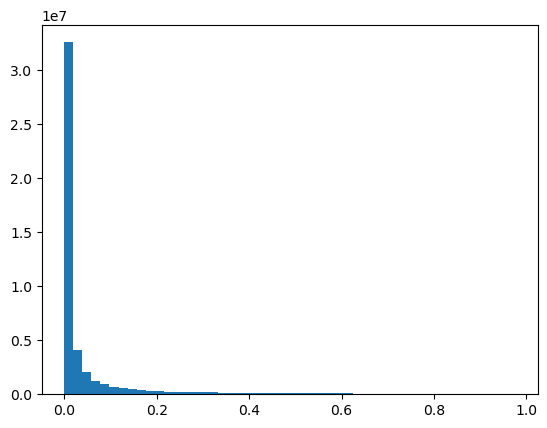

100% 26/26 [00:07<00:00,  3.53it/s]


1


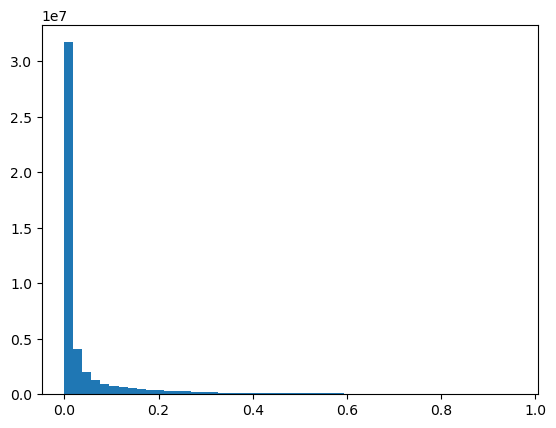

100% 26/26 [00:06<00:00,  3.75it/s]


2


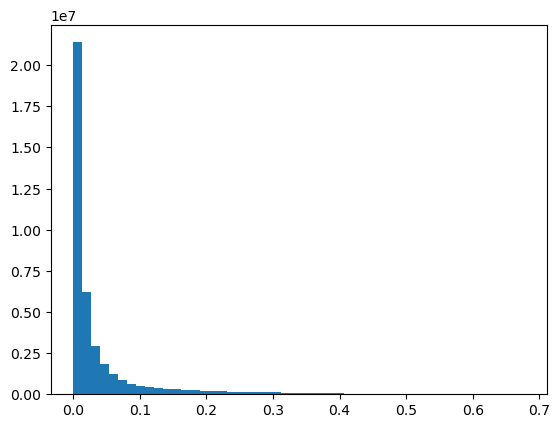

100% 26/26 [00:06<00:00,  4.32it/s]


3


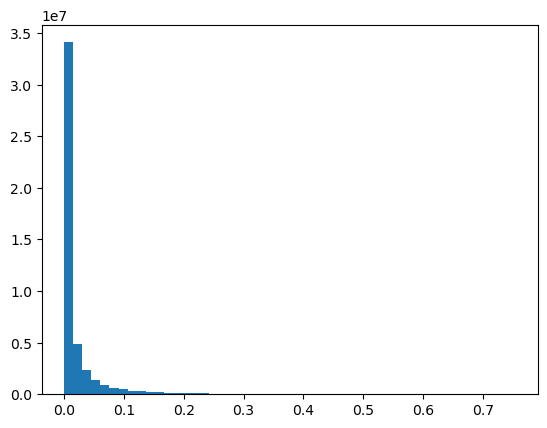

100% 26/26 [00:06<00:00,  3.76it/s]


4


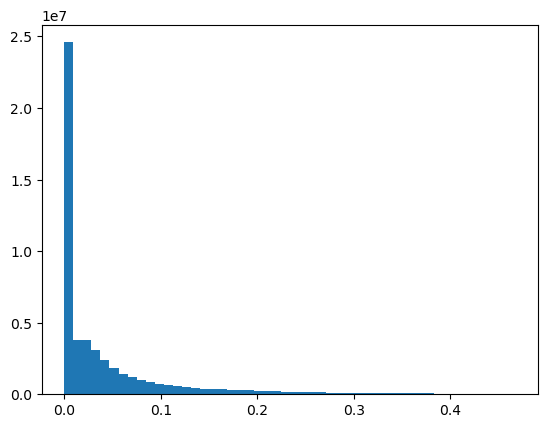

100% 26/26 [00:07<00:00,  3.39it/s]


In [ ]:
# all_preds.append(cv2.GaussianBlur(pred_tile_img, (127, 127), 64).reshape(-1))
from sklearn.metrics import fbeta_score

from torchmetrics.classification import BinaryFBetaScore
metric = BinaryFBetaScore(beta=0.5).to("cuda")

# score = fbeta_score(y_true, y_pred, beta=0.5)

thr_scores = []

if is_train:

    for fold in range(5):

        print(fold)

        flat_preds = all_preds[fold].astype(np.float)
        flat_masks = (all_masks[fold] / 255).astype(int)
        flat_masks_torch = (
            torch.from_numpy(flat_masks.astype(np.int)).clone().to("cuda")
        )

        plt.hist(flat_preds, bins=50)
        plt.show()

        thr_list = []
        for thr in tqdm(np.arange(0.1, 0.75, 0.025)):
            _val_pred = np.where(flat_preds > thr, 1, 0).astype(np.int)
            #score = fbeta_score(flat_masks, _val_pred, beta=0.5)
            
            _val_pred_torch = (
                torch.from_numpy(_val_pred.astype(np.int)).clone().to("cuda")
            )
            score = metric(_val_pred_torch, flat_masks_torch)
            
            # print(thr, score)
            thr_list.append({"thr": thr, "score": score})

            thr_scores.append({"fold": fold, "thr": thr, "score": score})

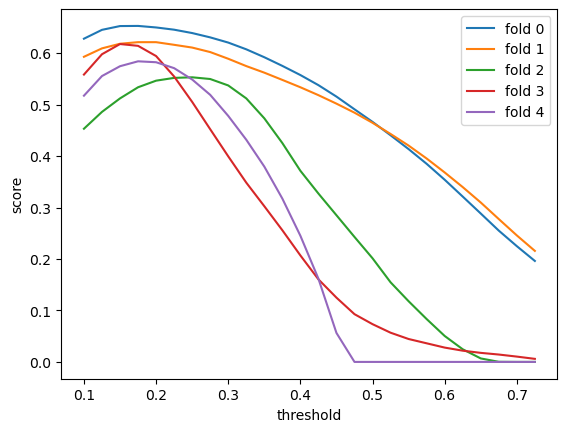

,thr,score
fold,,
0,0.175,"tensor(0.6528, device='cuda:0')"
1,0.175,"tensor(0.6213, device='cuda:0')"
2,0.250,"tensor(0.5530, device='cuda:0')"
3,0.150,"tensor(0.6177, device='cuda:0')"
4,0.175,"tensor(0.5841, device='cuda:0')"


0.185
0.6057708263397217


In [ ]:
if is_train:
    thr_scores_df = pd.DataFrame(thr_scores)
    for fold, fold_df in thr_scores_df.groupby("fold"):
        plt.plot(fold_df["thr"], fold_df["score"], label=f"fold {fold}")
    plt.legend()
    plt.xlabel("threshold")
    plt.ylabel("score")
    plt.show()
    best_thr_scores = (
        thr_scores_df.sort_values("score", ascending=False).groupby("fold").first()
    )
    display(best_thr_scores)

    print(best_thr_scores["thr"].mean())

    print(best_thr_scores["score"].mean())

In [ ]:
thr_scores_df.groupby("thr")["score"].mean().to_frame()

,score
thr,
0.100,0.549921
0.125,0.578709
0.150,0.595002
0.175,0.601195
0.200,0.598828
0.225,0.587763
0.250,0.571343
0.275,0.550669
0.300,0.524815


In [ ]:
if is_train:
    
    _best_thr_scores = best_thr_scores.copy()
    _best_thr_scores["idx"] = [f"fbeta_score{i}" for i in _best_thr_scores.index]
    _best_thr_scores = _best_thr_scores.set_index("idx")
    print(_best_thr_scores["score"].to_dict())
    print("score_mean", best_thr_scores["score"].mean())

    _best_thr_scores = best_thr_scores.copy()
    _best_thr_scores["idx"] = [f"thr{i}" for i in _best_thr_scores.index]
    _best_thr_scores = _best_thr_scores.set_index("idx")
    print(_best_thr_scores["thr"].to_dict())
    print("thr_mean", best_thr_scores["thr"].mean())

    print(aucs)


{'fbeta_score0': tensor(0.6528, device='cuda:0'), 'fbeta_score1': tensor(0.6213, device='cuda:0'), 'fbeta_score2': tensor(0.5530, device='cuda:0'), 'fbeta_score3': tensor(0.6177, device='cuda:0'), 'fbeta_score4': tensor(0.5841, device='cuda:0')}
score_mean 0.6057708263397217
{'thr0': 0.175, 'thr1': 0.175, 'thr2': 0.24999999999999997, 'thr3': 0.15, 'thr4': 0.175}
thr_mean 0.185
{'auc0': 0.8816381013279992, 'auc1': 0.8810140228738598, 'auc2': 0.9087214059254429, 'auc3': 0.9373230541105297, 'auc4': 0.917457926722141}


# Inference

In [ ]:
import numpy as np
from PIL import Image


def predict(test_data_dir, thr=0.5):
    
    _im = cv2.imread(str(test_data_dir / f"surface_volume/00.tif"), 0)
    
    pred_tile_img = np.zeros((_im.shape[0], _im.shape[1]))


    # mask
    test_mask = cv2.imread(str(test_data_dir / "mask.png"), 0)

    ## 推論
    nets = []

    for fold in range(0, 5):
        net = Unet()
        net.to(device)
        net.load_state_dict(torch.load(OUTPUT_DIR / f"{EXP_NAME}_{fold}.pt"))
        # net.load_state_dict(torch.load('/kaggle/input/ink-model/DESKTOP-M3SEAIN_exp0001_checkpoint_0.pt'))
        nets.append(net)

    for _idxs in [idxs, idxs2, idxs3]:
        
        test_img = []
        for i in tqdm(_idxs):
            test_img.append(
                cv2.imread(str(test_data_dir / f"surface_volume/{i:02}.tif"), 0)
            )

        

        test_img = np.stack(test_img)
        print(test_img.shape)
        

        test_dataloaders = []

        for j in range(Config.PREDICT_STRIDE):

            test_dataset = CVDataSet(
                [
                    test_img[
                        :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ]
                ],
                get_test_augmentation(),
                data_type="test",
                crop_size=Config.IMG_SIZE,
            )
            testloader = DataLoader(
                test_dataset,
                batch_size=Config.BATCH_SIZE // 2,
                pin_memory=True,
                num_workers=Config.NUM_WORKERS,
            )

            test_dataloaders.append(testloader)

        h_flip_test_dataloaders = []

        for j in range(Config.PREDICT_STRIDE):

            test_dataset = CVDataSet(
                [
                    np.flip(test_img, 2)[
                        :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ]
                ],
                get_test_augmentation(),
                data_type="test",
                crop_size=Config.IMG_SIZE,
            )
            testloader = DataLoader(
                test_dataset,
                batch_size=Config.BATCH_SIZE // 2,
                pin_memory=True,
                num_workers=Config.NUM_WORKERS,
            )

            h_flip_test_dataloaders.append(testloader)

        pred_tile_imgs = np.zeros((test_img[0].shape[0], test_img[0].shape[1]))
        for j, testloader in enumerate(test_dataloaders):

            # shift
            for epoch in range(1):

                test_preds = []
                n_iter_val = len(testloader)
                for i, (img, target_mask, target_class) in tqdm(enumerate(testloader), total=n_iter_val):

                    with torch.no_grad():
                        img, target_mask, target_class = img.to(device).float(), target_mask.to(device).float(), target_class.to(device).float()

                        outputs_all = np.zeros(
                            (img.shape[0], img.shape[2], img.shape[3])
                        )

                        for net in nets:
                            net.eval()
                            outputs_mask, outputs_class = net(img)
                            outputs_mask = outputs_mask.sigmoid()
                            outputs_np = (
                                outputs_mask.squeeze().to("cpu").detach().numpy().copy()
                            )
                            # print(outputs_np.shape)
                            # print(outputs_all.shape)
                            outputs_all += outputs_np / len(nets)
                            outputs_class = outputs_class.to("cpu").detach().numpy().ravel()
                        test_preds.append(outputs_all)

            w_count = math.ceil(
                test_img[0][
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                ].shape[1]
                / Config.IMG_SIZE
            )
            h_count = math.ceil(
                test_img[0][
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                ].shape[0]
                / Config.IMG_SIZE
            )

            # w_count = math.ceil(test_img[0].shape[1] / Config.IMG_SIZE)
            # h_count = math.ceil(test_img[0].shape[0] / Config.IMG_SIZE)

            tile_arry = []
            stack_pred = np.vstack(test_preds).reshape(
                -1, Config.IMG_SIZE, Config.IMG_SIZE
            )
            for h_i in range(h_count):
                tile_arry.append(stack_pred[h_i * w_count : (h_i + 1) * w_count])

            _pred_tile_img = concat_tile(tile_arry)

            _pred_tile_img = np.where(
                test_mask[
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                ]
                > 1,
                _pred_tile_img[
                    : test_img[0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ].shape[0],
                    : test_img[0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ].shape[1],
                ],
                0,
            )

            shift_pred_tile_img = np.zeros((test_img[0].shape[0], test_img[0].shape[1]))
            shift_pred_tile_img[
                (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
            ] = _pred_tile_img

            # plt.figure(figsize=(10, 10))
            # plt.imshow(shift_pred_tile_img)
            # plt.show()

            pred_tile_imgs += shift_pred_tile_img / Config.PREDICT_STRIDE

        pred_tile_img += pred_tile_imgs / 6

        pred_tile_imgs = np.zeros((test_img[0].shape[0], test_img[0].shape[1]))
        for j, testloader in enumerate(h_flip_test_dataloaders):

            # shift
            for epoch in range(1):

                test_preds = []
                n_iter_val = len(testloader)
                for i, (img, target) in tqdm(enumerate(testloader), total=n_iter_val):

                    with torch.no_grad():
                        img, target = img.to(device).float(), target.to(device).float()

                        outputs_all = np.zeros(
                            (img.shape[0], img.shape[2], img.shape[3])
                        )

                        for net in nets:
                            net.eval()
                            outputs_mask, outputs_class = net(img)
                            outputs_mask = outputs_mask.sigmoid()
                            outputs_np = (
                                outputs_mask.squeeze().to("cpu").detach().numpy().copy()
                            )
                            outputs_class = outputs_class.to("cpu").detach().numpy().ravel()
                            # print(outputs_np.shape)
                            # print(outputs_all.shape)
                            outputs_all += outputs_np / len(nets)

                        test_preds.append(outputs_all)

            w_count = math.ceil(
                test_img[0][
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                ].shape[1]
                / Config.IMG_SIZE
            )
            h_count = math.ceil(
                test_img[0][
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                ].shape[0]
                / Config.IMG_SIZE
            )

            # w_count = math.ceil(test_img[0].shape[1] / Config.IMG_SIZE)
            # h_count = math.ceil(test_img[0].shape[0] / Config.IMG_SIZE)

            tile_arry = []
            stack_pred = np.vstack(test_preds).reshape(
                -1, Config.IMG_SIZE, Config.IMG_SIZE
            )
            for h_i in range(h_count):
                tile_arry.append(stack_pred[h_i * w_count : (h_i + 1) * w_count])

            _pred_tile_img = concat_tile(tile_arry)

            _pred_tile_img = np.where(
                np.flip(test_mask, 1)[
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                ]
                > 1,
                _pred_tile_img[
                    : test_img[0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ].shape[0],
                    : test_img[0][
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                        (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                    ].shape[1],
                ],
                0,
            )

            shift_pred_tile_img = np.zeros((test_img[0].shape[0], test_img[0].shape[1]))
            shift_pred_tile_img[
                (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
                (Config.IMG_SIZE // Config.PREDICT_STRIDE) * j :,
            ] = _pred_tile_img

            # plt.figure(figsize=(10, 10))
            # plt.imshow(shift_pred_tile_img)
            # plt.show()

            pred_tile_imgs += np.flip(shift_pred_tile_img, 1) / Config.PREDICT_STRIDE

        pred_tile_img += pred_tile_imgs / 6

        del pred_tile_imgs, shift_pred_tile_img

    pred_tile_img = cv2.GaussianBlur(
        pred_tile_img, (65, 65), 32
    )  # cv2.GaussianBlur(pred_tile_img, (191, 191), 64)

    return pred_tile_img

In [ ]:
test_root_dir = DATA_DIR / "test/*"

pred_list = []
for f in glob.glob(str(test_root_dir)):
    print(f)
    pred_tile_img = predict(Path(f))

    if is_train:
        plt.figure(figsize=(20, 20))
    plt.imshow(pred_tile_img)
    plt.show()

    if is_train:
        plt.figure(figsize=(20, 20))
    plt.imshow(np.where(pred_tile_img > 0.475, 1, 0))
    plt.show()

    starts_ix, lengths = rle(pred_tile_img.reshape(-1), 0.475)
    inklabels_rle = " ".join(map(str, sum(zip(starts_ix, lengths), ())))
    inklabels_rle

    pred_list.append({"Id": str(f).split("/")[-1], "Predicted": inklabels_rle})

/working/input/vesuvius-challenge-ink-detection/test/a


100% 4/4 [00:04<00:00,  1.05s/it]

(4, 2727, 6330)



100% 25/25 [00:07<00:00,  3.33it/s]
100% 20/20 [00:06<00:00,  3.18it/s]
100% 20/20 [00:06<00:00,  3.12it/s]
100% 20/20 [00:06<00:00,  3.15it/s]
100% 20/20 [00:06<00:00,  3.11it/s]
100% 18/18 [00:05<00:00,  3.03it/s]
100% 18/18 [00:05<00:00,  3.00it/s]
100% 18/18 [00:05<00:00,  3.08it/s]
100% 18/18 [00:06<00:00,  3.00it/s]
100% 18/18 [00:05<00:00,  3.03it/s]
  0% 0/25 [00:00<?, ?it/s]


ValueError: too many values to unpack (expected 2)

: 

In [ ]:
pd.DataFrame(pred_list).to_csv("submission.csv", index=False)

In [ ]:
pd.DataFrame(pred_list)